<a href="https://colab.research.google.com/github/namakula-josephine/models/blob/main/Student_Grade_prediction_models_new.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <div style="color:yellow;display:inline-block;border-radius:5px;background-color:#007BA7;font-family:Nexa;overflow:hidden"><p style="padding:15px;color:yellow;overflow:hidden;font-size:85%;letter-spacing:0.5px;margin:0"><b> </b> Data Preprocessing</p></div>



In [ ]:
!pip install hmmlearn
!pip install colorama
!pip install shap lime



import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.ensemble import GradientBoostingRegressor, GradientBoostingClassifier
from sklearn.svm import SVR, SVC
from sklearn.neighbors import KNeighborsRegressor, KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPRegressor, MLPClassifier
from sklearn.decomposition import PCA
from sklearn.gaussian_process import GaussianProcessRegressor
from hmmlearn.hmm import GaussianHMM
from sklearn.linear_model import ElasticNet, Ridge, Lasso
from sklearn.ensemble import AdaBoostRegressor, AdaBoostClassifier
from xgboost import XGBRegressor, XGBClassifier





import warnings
warnings.filterwarnings('ignore')

import math

rc = {
    "axes.facecolor": "#ffffff",
    "figure.facecolor": "#ffffff",
    "axes.edgecolor": "#000000",
    "grid.color": "#EBEBE7",
    "font.family": "serif",
    "axes.labelcolor": "#000000",
    "xtick.color": "#000000",
    "ytick.color": "#000000",
    "grid.alpha": 0.4
}

sns.set(rc=rc)

from colorama import Style, Fore
red = Style.BRIGHT + Fore.RED
blu = Style.BRIGHT + Fore.BLUE
mgt = Style.BRIGHT + Fore.MAGENTA
gld = Style.BRIGHT + Fore.YELLOW
res = Style.RESET_ALL

<div style="border-radius:10px; border:#457B9D solid; padding: 15px; background-color:#E6FFE6; font-size:100%; text-align:left">

<html>
<head>
<style>
table {
  border-collapse: collapse;
  width: 100%;
  font-family: Arial, sans-serif;
}

th, td {
  border: 1px solid #dddddd;
  text-align: left;
  padding: 8px;
}

th {
  background-color: #f2f2f2;
}
</style>
</head>
<body>

<h2>Dataset Attribute Descriptions</h2>

<table>
  <tr>
    <th>Attribute Description </th>
    <th>Values</th>
  </tr>
  <tr>
    <td>Demographics - Gender Binary</td>
    <td>Female (0), Male (1)</td>
  </tr>
  <tr>
    <td>Social Status</td>
    <td>Single (0), Married (1), Apart (2)</td>
  </tr>
  <!-- Add more rows for the remaining attributes -->
  <tr>
    <td>Age</td>
    <td>1: &lt;17 years<br>2: 17-19 years<br>3: 19-21 years<br>4: &gt;21 years</td>
  </tr>
  <tr>
    <td>Governorate Binary</td>
    <td>Baghdad (0), Other (1)</td>
  </tr>
  <tr>
    <td>Living Binary</td>
    <td>City (0), Rural (1)</td>
  </tr>
  <tr>
    <td>Mother Education</td>
    <td>0: Illiterate<br>1: Medium<br>2: Secondary<br>3: B.A.<br>4: Higher</td>
  </tr>
  <tr>
    <td>Father Education</td>
    <td>0: Illiterate<br>1: Medium<br>2: Secondary<br>3: B.A.<br>4: Higher</td>
  </tr>
  <tr>
    <td>Family Member Education Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>Father Alive Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>Mother Alive Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>Family Size Numeric</td>
    <td>0: &lt;4 members<br>1: 4-8 members<br>2: &gt;8 members</td>
  </tr>
  <tr>
    <td>Parent Apart Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>The Guardian</td>
    <td>Mother (0), Father (1), Null (2)</td>
  </tr>
  <tr>
    <td>Family Relationship</td>
    <td>0: Bad<br>1: Good<br>2: Vgood<br>3: Excellent</td>
  </tr>
  <tr>
    <td>Economic - Father Job</td>
    <td>0: No<br>1: Employee<br>2: Other</td>
  </tr>
  <tr>
    <td>Economic - Mother Job</td>
    <td>0: No<br>1: Employee<br>2: Other</td>
  </tr>
  <tr>
    <td>Economic - Education Fee Binary</td>
    <td>You (0), Family (1)</td>
  </tr>
  <tr>
    <td>Economic - Secondary Job Binary</td>
    <td>Free Job (0), No (1)</td>
  </tr>
  <tr>
    <td>Economic - Home Ownership Binary</td>
    <td>Own (0), Rent (1)</td>
  </tr>
  <tr>
    <td>Study Room Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>Family Economic Level</td>
    <td>0: Poor<br>1: Good<br>2: Vgood<br>3: Excellent</td>
  </tr>
  <tr>
    <td>You Chronic Disease Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>Family Chronic Disease Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>Education - Specialization Binary</td>
    <td>Applicable (0), Biologist (1)</td>
  </tr>
  <tr>
    <td>Education - Study Willing Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>Education - Reason of Study</td>
    <td>You (0), Average (1), Family (2)</td>
  </tr>
  <tr>
    <td>Attendance</td>
    <td>0: Poor<br>1: Good<br>2: Vgood</td>
  </tr>
  <tr>
    <td>Failure Year Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>Higher Education Willing Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>References Usage Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>Time - Internet Usage</td>
    <td>0: &lt;2 hours<br>1: 2-4 hours<br>2: &gt;4 hours</td>
  </tr>
  <tr>
    <td>Time - TV Usage</td>
    <td>0: &lt;2 hours<br>1: 2-4 hours<br>2: &gt;4 hours</td>
  </tr>
  <tr>
    <td>Time - Sleep Hour</td>
    <td>0: &lt;5 hours<br>1: 5-7 hours<br>2: 7-9 hours<br>3: &gt;9 hours</td>
  </tr>
  <tr>
    <td>Time - Study Hour</td>
    <td>0: &gt;2 hours<br>1: 2-4 hours<br>2: 4-6 hours<br>3: &gt;6 hours</td>
  </tr>
  <tr>
    <td>Time - Arrival Time</td>
    <td>0: &lt;hour<br>1: Other</td>
  </tr>
  <tr>
    <td>Time - Transport Binary</td>
    <td>Foot (0), Car (1)</td>
  </tr>
  <tr>
    <td>Time - Holiday Effect Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>Time - Worry Effect Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>Parent Meeting Binary</td>
    <td>Yes (0), No (1)</td>
  </tr>
  <tr>
    <td>Marks - Materials Degrees for First Semester Numeric</td>
    <td>0-100</td>
  </tr>
  <tr>
    <td>Marks - Avg1 Numeric</td>
    <td>0-100</td>
  </tr>
  <tr>
    <td>Marks - Materials Degrees for... [Incomplete]</td>
    <td>N/A</td>
  </tr>
</table>

</body>
</html>


# <div style="color:yellow;display:inline-block;border-radius:5px;background-color:#007BA7;font-family:Nexa;overflow:hidden"><p style="padding:15px;color:yellow;overflow:hidden;font-size:70%;letter-spacing:0.5px;margin:0"><b> </b> Load the Dataset</p></div>

In [ ]:
# Read the CSV file
data = pd.read_csv('Iraqi Student Performance Prediction.csv')
data.head().style.set_properties(**{'color':'black','border-color':'#8b8c8c'})

,Student_ID,Sex,Social Status,Age,Governorate,Living,Mother education,Father education,Family member Education,Father Alive,Mother Alive,Family Size,Parent Apart,The Guardian,Family Relationship,Father Job,Mother Job,Education Fee,Secondary Job,Home Ownership,Study Room,Family Economic Level,You chronic disease,Family Chronic Disease,Specialization,Study willing,Reason of study,Attendance,Failure Year,Higher Education Willing,References Usage,Internet Usage,TV Usage,Sleep Hour,Study Hour,Arrival Time,Transport,Holiday Effect,Worry Effect,Parent Meeting,Islamea,arabic,english,math,physics,chemistry,economy/bio,Avg1,Islamea.1,arabic.1,english.1,math.1,physics.1,chemistry.1,economy/bio.1,Avg1.1
0,1,Male,single,2,baghdad,city,secondary,secondary,yes,yes,yes,0,no,nan,excellent,employee,employee,family,no,own,no,good,no,no,APP,yes,you,vgood,no,yes,yes,1,0,1,3,0,foot,yes,no,yes,54,60,78,25,60,41,70,55,69,50,60,41,59,50,69,57
1,2,Male,single,3,baghdad,city,medium,higher,yes,yes,yes,1,no,nan,excellent,employee,no,family,no,own,yes,vgood,no,yes,APP,yes,you,vgood,yes,no,yes,2,0,2,0,0,foot,yes,yes,yes,70,77,70,59,53,72,87,70,65,87,68,85,64,61,69,71
2,3,Male,single,2,baghdad,city,Illiterate,secondary,no,yes,yes,0,no,nan,good,employee,no,family,no,own,no,good,no,no,APP,yes,you,good,yes,no,no,2,0,2,0,0,foot,yes,yes,no,73,62,50,45,57,35,58,54,44,50,46,45,55,30,43,45
3,4,Male,coupled,3,baghdad,city,ba,ba,yes,yes,yes,0,no,nan,excellent,other,employee,you,freejob,own,yes,vgood,no,no,APP,no,you,good,no,no,yes,0,0,1,1,1,foot,no,yes,yes,70,65,77,68,77,62,92,73,60,55,60,55,70,73,80,65
4,5,Male,single,2,baghdad,city,secondary,secondary,yes,yes,yes,1,no,nan,excellent,employee,employee,family,freejob,own,yes,vgood,no,no,APP,yes,average,good,no,yes,yes,1,0,1,1,1,foot,no,yes,yes,50,35,30,15,20,28,60,34,40,32,28,25,35,25,40,32


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 120 entries, 0 to 119
Data columns (total 56 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Student_ID                120 non-null    int64 
 1   Sex                       120 non-null    object
 2   Social Status             120 non-null    object
 3   Age                       120 non-null    int64 
 4   Governorate               120 non-null    object
 5   Living                    120 non-null    object
 6   Mother education          120 non-null    object
 7   Father education          120 non-null    object
 8   Family member Education   120 non-null    object
 9   Father Alive              120 non-null    object
 10  Mother Alive              120 non-null    object
 11  Family Size               120 non-null    int64 
 12  Parent Apart              120 non-null    object
 13  The Guardian              21 non-null     object
 14  Family Relationship       

In [ ]:
data.columns

Index(['Student_ID', 'Sex', 'Social Status', 'Age', 'Governorate', 'Living',
       'Mother education', 'Father education', 'Family member Education',
       'Father Alive', 'Mother Alive', 'Family Size', 'Parent Apart',
       'The Guardian', 'Family Relationship', 'Father Job', 'Mother Job',
       'Education Fee', 'Secondary Job', 'Home Ownership', 'Study Room',
       'Family Economic Level', 'You  chronic disease',
       'Family Chronic Disease', 'Specialization', 'Study willing',
       'Reason of study', 'Attendance', 'Failure Year',
       'Higher Education Willing', 'References Usage', 'Internet Usage',
       'TV Usage', 'Sleep Hour', 'Study Hour', 'Arrival Time', 'Transport',
       'Holiday Effect', 'Worry Effect', 'Parent Meeting', 'Islamea', 'arabic',
       'english', 'math', 'physics', 'chemistry', 'economy/bio', 'Avg1',
       'Islamea.1', 'arabic.1', 'english.1', 'math.1', 'physics.1',
       'chemistry.1', 'economy/bio.1', 'Avg1.1'],
      dtype='object')

### We'll handle missing values and select relevant features:

In [ ]:
# Check for missing values in each column
missing_values = data.isnull().sum()
missing_values

Student_ID                   0
Sex                          0
Social Status                0
Age                          0
Governorate                  0
Living                       0
Mother education             0
Father education             0
Family member Education      0
Father Alive                 0
Mother Alive                 0
Family Size                  0
Parent Apart                 0
The Guardian                99
Family Relationship          0
Father Job                   0
Mother Job                   0
Education Fee                0
Secondary Job                0
Home Ownership               0
Study Room                   0
Family Economic Level        0
You  chronic disease         0
Family Chronic Disease       0
Specialization               0
Study willing                0
Reason of study              0
Attendance                   0
Failure Year                 0
Higher Education Willing     0
References Usage             0
Internet Usage               0
TV Usage

In [ ]:
# Handling missing values
data = data.dropna()

# <div style="color:yellow;display:inline-block;border-radius:5px;background-color:#007BA7;font-family:Nexa;overflow:hidden"><p style="padding:15px;color:yellow;overflow:hidden;font-size:85%;letter-spacing:0.5px;margin:0"><b> </b> Exploratory Data Analysis (EDA)</p></div>




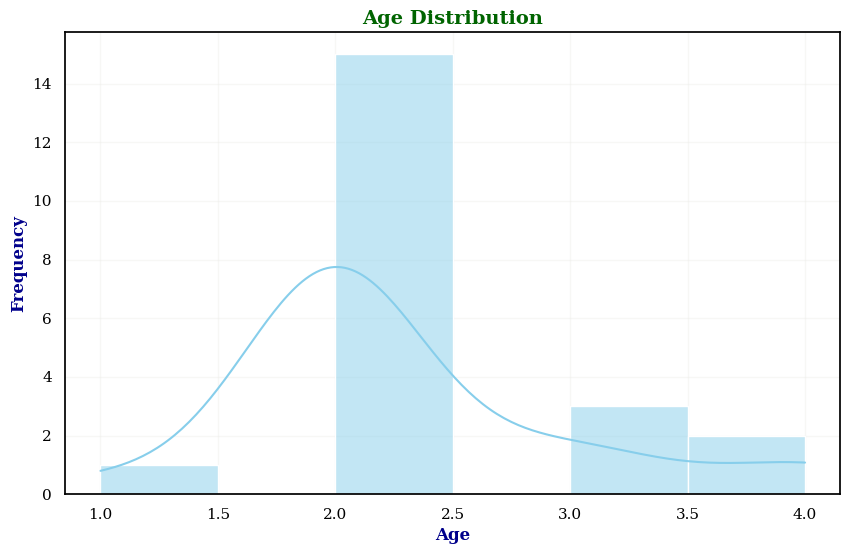

In [ ]:
# Plotting a distribution of age
plt.figure(figsize=(10, 6))
sns.histplot(data['Age'], kde=True, color='skyblue')
plt.title('Age Distribution', fontsize = 14, fontweight = 'bold', color = 'darkgreen')
plt.xlabel('Age', fontsize = 12, fontweight = 'bold', color = 'darkblue')
plt.ylabel('Frequency', fontsize = 12, fontweight = 'bold', color = 'darkblue')
plt.savefig('Age Distribution.png')
plt.show()

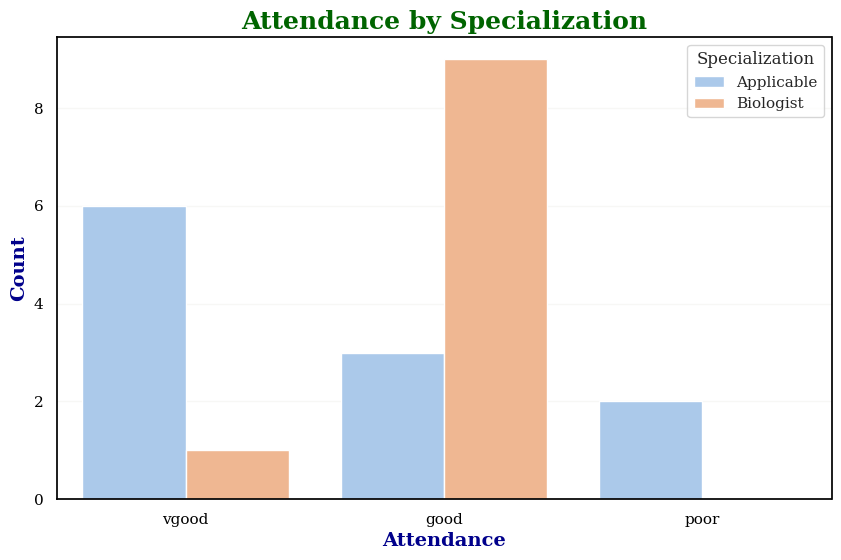

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(x='Attendance', hue='Specialization', data=data, palette='pastel')
plt.title('Attendance by Specialization', fontsize=18,fontweight = 'bold', color = 'darkgreen')
plt.xlabel('Attendance', fontsize=14, fontweight = 'bold', color = 'darkblue')
plt.ylabel('Count', fontsize=14, fontweight = 'bold', color = 'darkblue')
plt.legend(title='Specialization', labels=['Applicable', 'Biologist'])
ax = plt.gca()
#ax.set_facecolor('#F0F0F0')
plt.savefig('Attendance by Specialization.png')
plt.show()


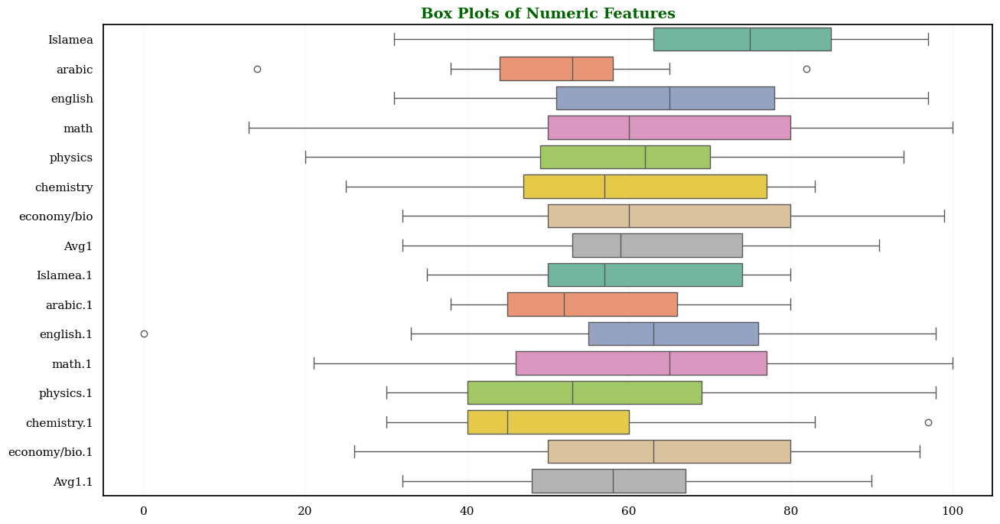

In [ ]:
# Selecting relevant numeric features
numeric_features = ['Islamea', 'arabic', 'english', 'math', 'physics', 'chemistry', 'economy/bio',
                    'Avg1', 'Islamea.1', 'arabic.1', 'english.1', 'math.1', 'physics.1', 'chemistry.1', 'economy/bio.1', 'Avg1.1']

# Box plots for selected numeric features
plt.figure(figsize=(15, 8))
sns.boxplot(data=data[numeric_features], orient="h", palette="Set2")
plt.title("Box Plots of Numeric Features", fontsize = 14, fontweight = 'bold', color = 'darkgreen')
plt.savefig('Box Plots of Numeric Features.png')
plt.show()

In [ ]:
# Calculate some summary statistics
age_stats = data['Age'].describe()

# Create a DataFrame for the results table
results_table = pd.DataFrame({
    'Statistic': ['Mean', 'Median', 'Min', 'Max', 'Std. Dev.'],
    'Value': [age_stats['mean'], age_stats['50%'], age_stats['min'], age_stats['max'], age_stats['std']]
})

print(results_table)


   Statistic     Value
0       Mean  2.285714
1     Median  2.000000
2        Min  1.000000
3        Max  4.000000
4  Std. Dev.  0.717137


       Student_ID        Age  Family Size  Internet Usage   TV Usage  \
count   21.000000  21.000000    21.000000       21.000000  21.000000   
mean    60.619048   2.285714     0.476190        0.523810   0.095238   
std     36.004828   0.717137     0.679636        0.749603   0.436436   
min      6.000000   1.000000     0.000000        0.000000   0.000000   
25%     38.000000   2.000000     0.000000        0.000000   0.000000   
50%     55.000000   2.000000     0.000000        0.000000   0.000000   
75%     88.000000   2.000000     1.000000        1.000000   0.000000   
max    119.000000   4.000000     2.000000        2.000000   2.000000   

       Sleep Hour  Study Hour  Arrival Time    Islamea     arabic  ...  \
count   21.000000   21.000000     21.000000  21.000000  21.000000  ...   
mean     1.190476    2.000000      0.238095  71.190476  51.380952  ...   
std      0.872872    0.948683      0.436436  16.729074  13.551665  ...   
min      0.000000    0.000000      0.000000  31.000000 

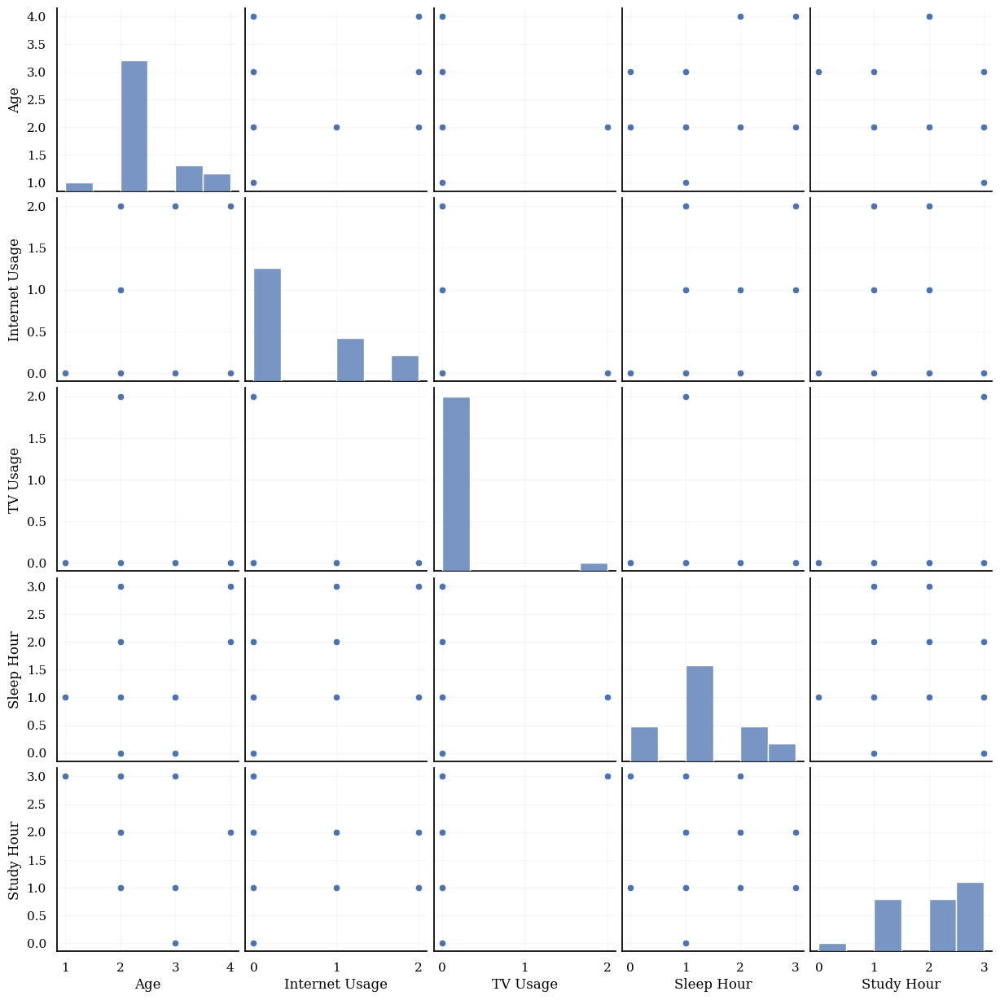

In [ ]:
# Get summary statistics
summary_stats = data.describe()

# Print summary statistics
print(summary_stats)

# Visualize relationships
import seaborn as sns
import matplotlib.pyplot as plt

# Pairplot for selected features
sns.pairplot(data[['Age', 'Internet Usage', 'TV Usage', 'Sleep Hour', 'Study Hour']])
plt.show()


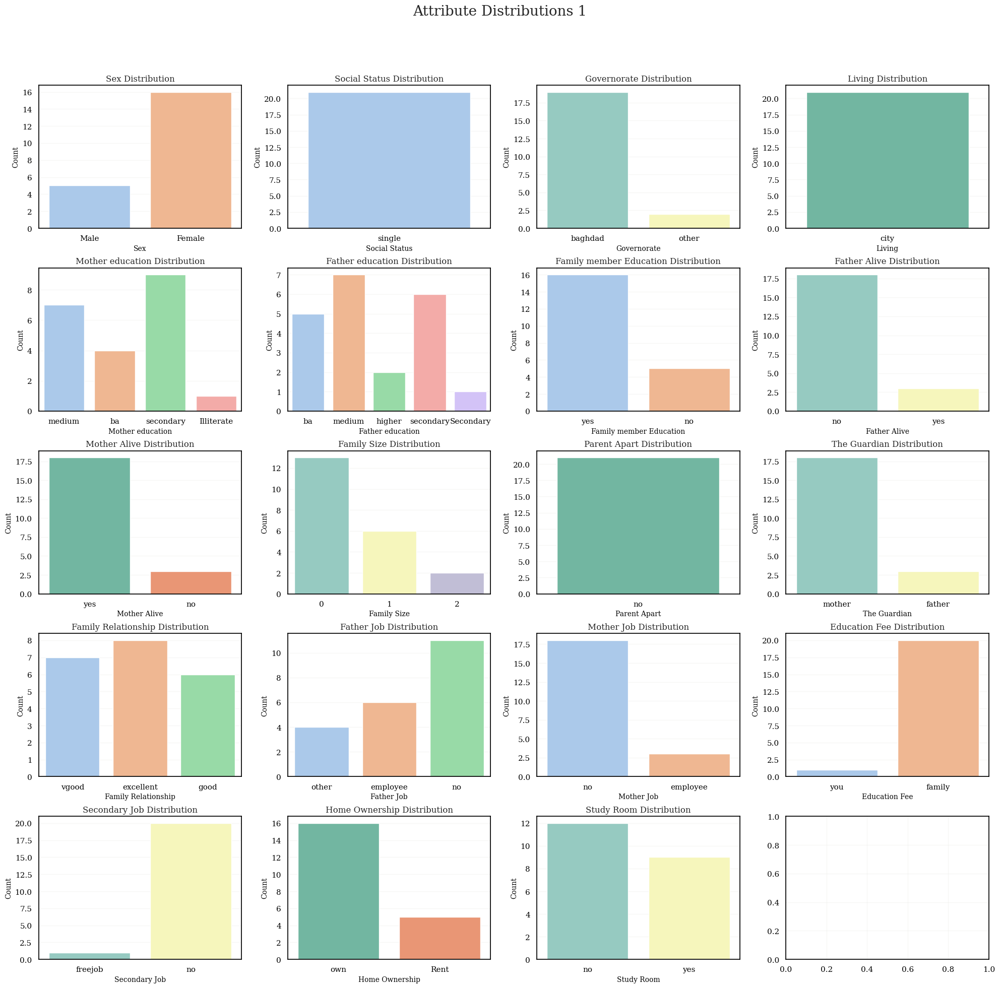

In [ ]:
# Set up subplots
fig, axes = plt.subplots(5, 4, figsize=(20, 20))

# Define attribute categories
categories = [
    'Sex', 'Social Status', 'Governorate', 'Living',
    'Mother education', 'Father education', 'Family member Education',
    'Father Alive', 'Mother Alive', 'Family Size', 'Parent Apart',
    'The Guardian', 'Family Relationship', 'Father Job', 'Mother Job',
    'Education Fee', 'Secondary Job', 'Home Ownership', 'Study Room',
]

# Define colors for each subplot
colors = ['pastel', 'pastel', 'Set3', 'Set2', 'pastel', 'pastel', 'pastel', 'Set3',
          'Set2', 'Set3', 'Set2', 'Set3', 'pastel', 'pastel', 'pastel', 'pastel',
          'Set3', 'Set2', 'Set3', 'Set2', 'pastel', 'pastel', 'pastel', 'pastel']

# Loop through categories and plot
for i, category in enumerate(categories):
    row = i // 4
    col = i % 4
    ax = axes[row, col]
    sns.countplot(x=category, data=data, palette=colors[i], ax=ax)
    ax.set_title(f'{category} Distribution', fontsize=12)
    ax.set_xlabel(category, fontsize=10)
    ax.set_ylabel('Count', fontsize=10)
    #ax.set_facecolor('#F0F0F0')

# Adjust layout
plt.tight_layout()
plt.subplots_adjust(top=0.9)

# Set overall title
plt.suptitle('Attribute Distributions 1', fontsize=20)

# Show plot
plt.show()


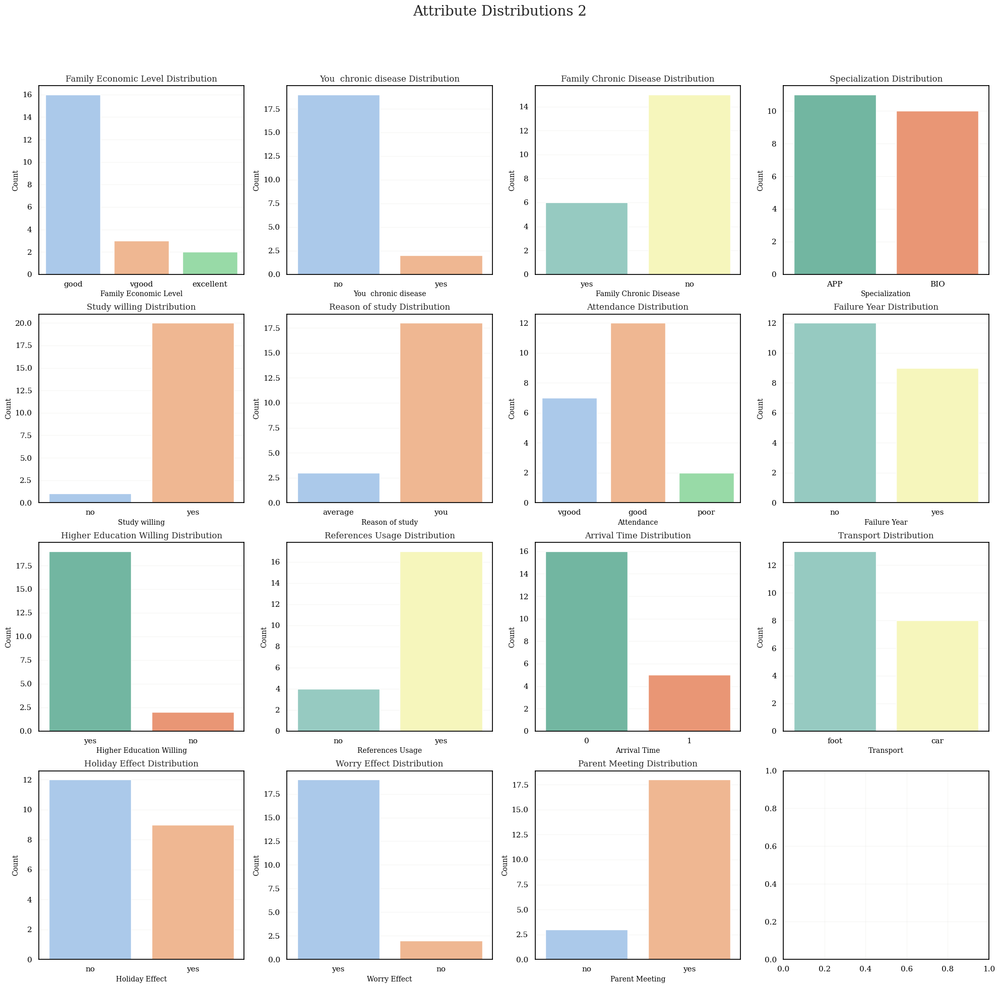

In [ ]:
# Set up subplots
fig, axes = plt.subplots(4, 4, figsize=(20, 20))

# Define attribute categories
categories = [
    'Family Economic Level', 'You  chronic disease',
    'Family Chronic Disease', 'Specialization', 'Study willing',
    'Reason of study', 'Attendance', 'Failure Year', 'Higher Education Willing', 'References Usage',
    'Arrival Time', 'Transport','Holiday Effect', 'Worry Effect', 'Parent Meeting'
]

# Define colors for each subplot
colors = ['pastel', 'pastel', 'Set3', 'Set2', 'pastel', 'pastel', 'pastel', 'Set3',
          'Set2', 'Set3', 'Set2', 'Set3', 'pastel', 'pastel', 'pastel', 'pastel']

# Loop through categories and plot
for i, category in enumerate(categories):
    row = i // 4
    col = i % 4
    ax = axes[row, col]
    sns.countplot(x=category, data=data, palette=colors[i], ax=ax)
    ax.set_title(f'{category} Distribution', fontsize=12)
    ax.set_xlabel(category, fontsize=10)
    ax.set_ylabel('Count', fontsize=10)
    #ax.set_facecolor('#F0F0F0')

# Adjust layout
plt.tight_layout()
plt.subplots_adjust(top=0.9)

# Set overall title
plt.suptitle('Attribute Distributions 2', fontsize=20)

# Show plot
plt.show()

In [ ]:
# Define attribute categories and their corresponding counts
categories = [
    'Sex', 'Social Status', 'Governorate', 'Living',
    'Mother education', 'Father education', 'Family member Education',
    'Father Alive', 'Mother Alive', 'Family Size', 'Parent Apart',
    'The Guardian', 'Family Relationship', 'Father Job', 'Mother Job',
    'Education Fee', 'Secondary Job', 'Home Ownership', 'Study Room',
    'Family Economic Level', 'You  chronic disease','Family Chronic Disease',
    'Specialization', 'Study willing','Reason of study', 'Attendance', 'Failure Year',
    'Higher Education Willing', 'References Usage', 'Arrival Time',
    'Transport','Holiday Effect', 'Worry Effect', 'Parent Meeting'
]

counts = [data[category].value_counts() for category in categories]

# Create a DataFrame for the table
table_data = pd.DataFrame(counts)
table_data.index = categories
table_data = table_data.transpose()

# Define a palette of colors
colors = ['#ffffff', '#ffffff', '#ffffff', '#ffffff', '#ffffff', '#ffffff', '#ffffff', '#ffffff']

# Create a dictionary to specify background colors
background_colors = {col: colors[i % len(colors)] for i, col in enumerate(table_data.columns)}

# Apply the background colors to the DataFrame
styled_table_data = table_data.style.apply(lambda col: [f'background-color: {background_colors[col.name]}' for _ in col], axis=0)

# Display the styled table
styled_table_data

,Sex,Social Status,Governorate,Living,Mother education,Father education,Family member Education,Father Alive,Mother Alive,Family Size,Parent Apart,The Guardian,Family Relationship,Father Job,Mother Job,Education Fee,Secondary Job,Home Ownership,Study Room,Family Economic Level,You chronic disease,Family Chronic Disease,Specialization,Study willing,Reason of study,Attendance,Failure Year,Higher Education Willing,References Usage,Arrival Time,Transport,Holiday Effect,Worry Effect,Parent Meeting
Female,16.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
Male,5.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
single,nan,21.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
baghdad,nan,nan,19.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
other,nan,nan,2.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,4.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
city,nan,nan,nan,21.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
secondary,nan,nan,nan,nan,9.000000,6.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
medium,nan,nan,nan,nan,7.000000,7.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
ba,nan,nan,nan,nan,4.000000,5.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
Illiterate,nan,nan,nan,nan,1.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


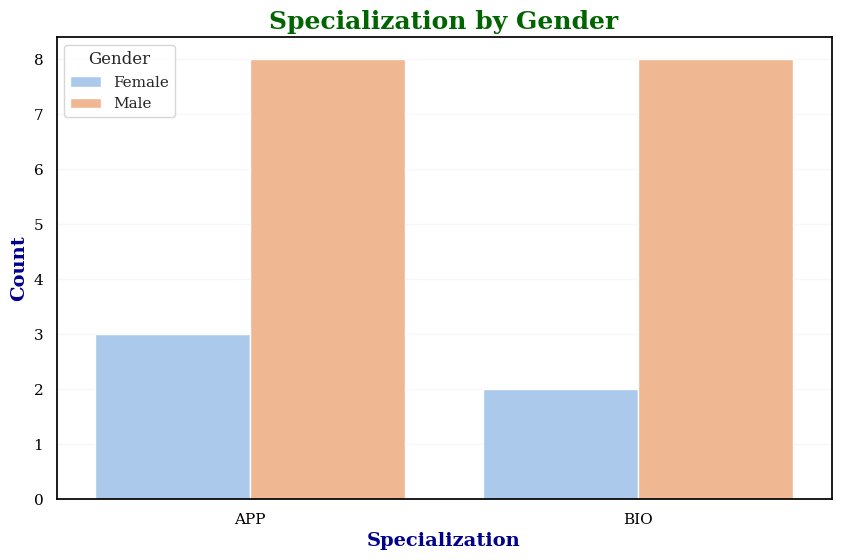

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(x='Specialization', hue='Sex', data=data, palette='pastel')
plt.title('Specialization by Gender', fontsize=18, fontweight = 'bold', color = 'darkgreen')
plt.xlabel('Specialization', fontsize=14, fontweight = 'bold', color = 'darkblue')
plt.ylabel('Count', fontsize=14, fontweight = 'bold', color = 'darkblue')
plt.legend(title='Gender', labels=['Female', 'Male'])
ax = plt.gca()
#ax.set_facecolor('#F0F0F0')
plt.savefig('Specialization by Gender.png')
plt.show()

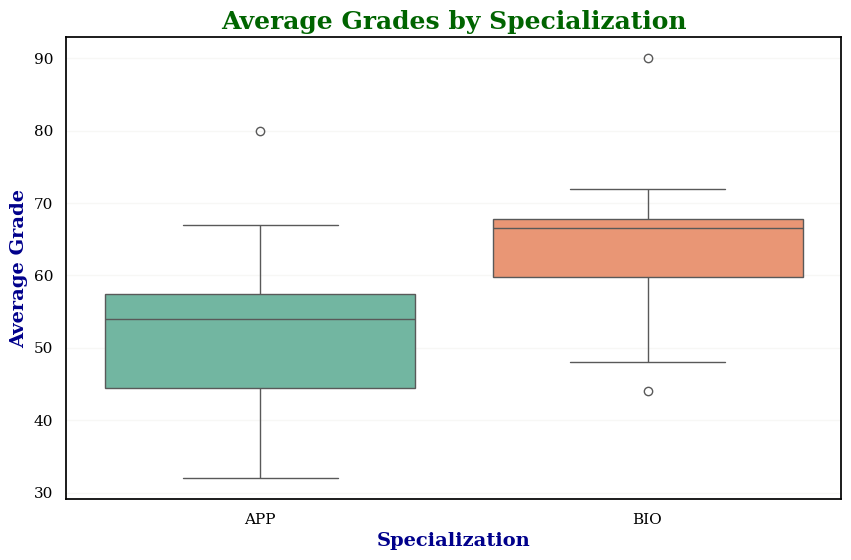

In [ ]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Specialization', y='Avg1.1', data=data, palette='Set2')
plt.title('Average Grades by Specialization', fontsize=18, fontweight = 'bold', color = 'darkgreen')
plt.xlabel('Specialization', fontsize=14, fontweight = 'bold', color = 'darkblue')
plt.ylabel('Average Grade', fontsize=14, fontweight = 'bold', color = 'darkblue')
ax = plt.gca()
#ax.set_facecolor('#F0F0F0')
plt.savefig('Average Grades by Specialization.png')
plt.show()

In [ ]:
data['Sex'] = np.where(data['Sex']=='Female',1,0)

# <div style="color:yellow;display:inline-block;border-radius:5px;background-color:#007BA7;font-family:Nexa;overflow:hidden"><p style="padding:15px;color:yellow;overflow:hidden;font-size:85%;letter-spacing:0.5px;margin:0"><b> </b>  Model and Prediction</p></div>

In [ ]:
# Handling missing values
data = data.dropna()

In [ ]:
# Separating features (X) and target (y)
X = data.drop(columns=['Avg1.1'])  # Removing the target column
y = data['Avg1.1']

In [ ]:
numerical = X.select_dtypes(include=['number'])
correlation_matrix = numerical.corr()

In [ ]:
# List of categorical features
categorical_features =X.select_dtypes(include=['object'])

# Impute missing values with the most common category
for feature in categorical_features:
    most_common_category = data[feature].mode()[0]
    data[feature].fillna(most_common_category, inplace=True)

# Check if there are any remaining missing values
missing_values = data.isnull().sum()
print(missing_values[missing_values > 0])


Series([], dtype: int64)


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from imblearn.over_sampling import  RandomOverSampler
from sklearn.preprocessing import StandardScaler

<html>
<body>
    <span style="color: green; font-weight: bold; font-size: 20px;">Linear Regression</span>
</body>
</html>


Mean Squared Error: 30.330186212084364
Mean Absolute Error: 4.222145945103703
R-squared: 0.25368636289162494
Mean Absolute Percentage Error (MAPE): 8.14%


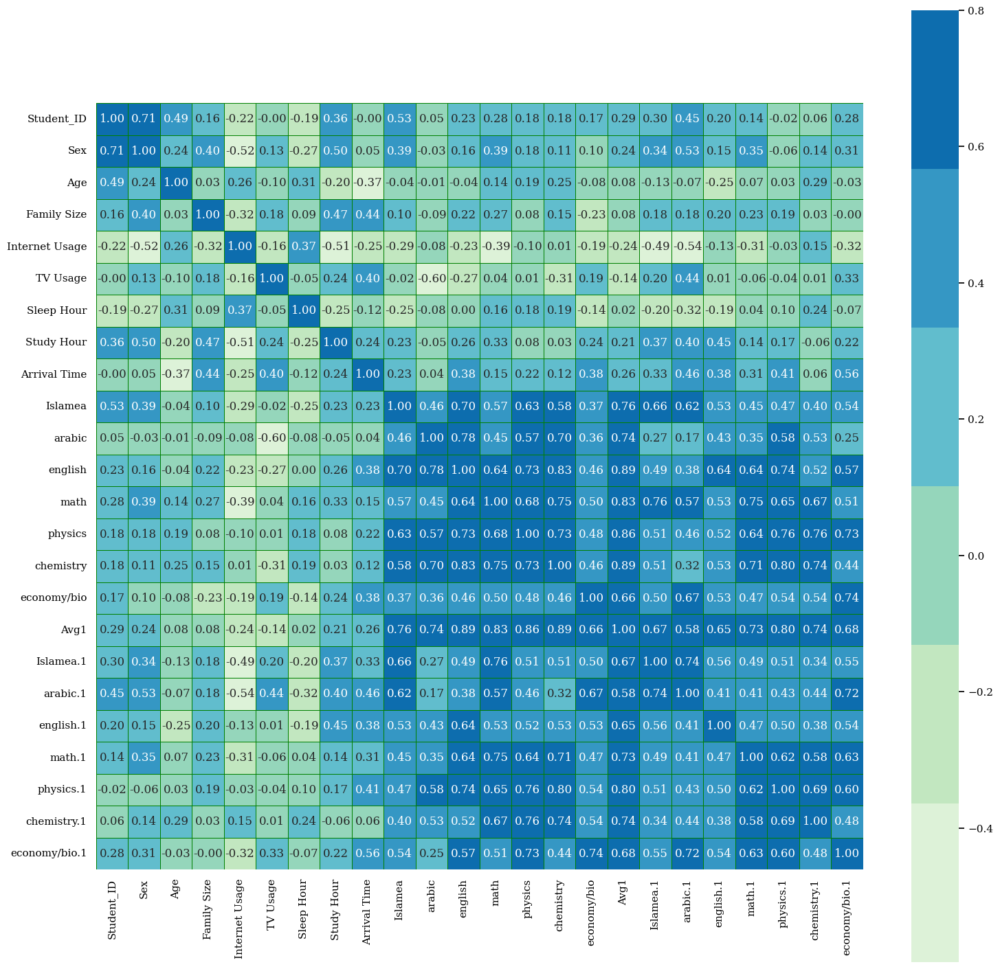

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

# Encoding categorical variables
categorical_features = pd.get_dummies(categorical_features,drop_first = True)
categorical_features.shape

# Removing features with zero variance

def unique_level(m):
    m = m.value_counts().count()
    return m
feature_val_count= pd.DataFrame(X.apply(lambda m: unique_level(m)))
feature_val_count.columns=['uni_level']
feat_level = feature_val_count.loc[feature_val_count['uni_level']>1]
feat_level_index = feat_level.index
X = X.loc[:,feat_level_index]


#Clapping and flooring outliers
def outlier_cap(x):
    x=x.clip(lower=x.quantile(0.01))
    x=x.clip(upper=x.quantile(0.99))
    return(x)

numerical=numerical.apply(lambda x : outlier_cap(x))

# Checking corelation between numefical featutes
plt.figure(figsize=(18,18))
cmap =sns.color_palette("GnBu",n_colors=6)
cor =numerical.corr()
sns.heatmap(cor,annot=True,vmax=0.8,cmap=cmap,fmt='.2f',linecolor='green',linewidths=0.7,square=True)


#  function for removing corelated feature
def correlMatrix(data,thres):
    correlated_features = set()
    correlation_matrix = data.corr()
    for i in range(len(correlation_matrix .columns)):
        for j in range(i):
            if abs(correlation_matrix.iloc[i, j]) > thres:
                colname = correlation_matrix.columns[i]
                correlated_features.add(colname)
    return correlated_features


#  show corelated column if corelation more than 0.75
correlated_feat = correlMatrix(numerical,0.75)
correlated_feat

# drop corelated features
numerical.drop(correlated_feat,axis=1,inplace=True)

# K Best for Selecting Categorical Features using k=20
from sklearn.feature_selection import SelectKBest, chi2
selector = SelectKBest(chi2, k=20)
selector.fit_transform(categorical_features, y)

cols = selector.get_support(indices=True)
X_ca= categorical_features.iloc[:,cols]

# joining all inpendent features
X_all=pd.concat([numerical,X_ca],axis=1,join='inner')

#Imbalanced to balanced dataset.
ros = RandomOverSampler(sampling_strategy='minority',random_state=1)
X_s,Y_s = ros.fit_resample(X_all, y)

# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_s, Y_s, test_size=0.2, random_state=42)

standard_Scaler=StandardScaler()
X_train = standard_Scaler.fit_transform(X_train)
X_test = standard_Scaler.transform(X_test)


# Step 2: Model Training
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100


# Step 3: Model Evaluation
y_pred_lr = lr_model.predict(X_test)

# Evaluate the model (e.g., using mean absolute percentage error)
mape_linear = mean_absolute_percentage_error(y_test, y_pred_lr)

# Evaluate the model (e.g., using mean absolute error)
mae_linear = mean_absolute_error(y_test, y_pred_lr)

# Evaluate the model (e.g., using mean squared error)
mse_linear = mean_squared_error(y_test, y_pred_lr)

# Evaluate the model (e.g., using R-squared)
r2_Linear = r2_score(y_test, y_pred_lr)

# Evaluate the model (e.g., using mean squared error)
mse = mean_squared_error(y_test, y_pred_lr)
print(f"Mean Squared Error: {mse}")
print(f'Mean Absolute Error: {mae_linear}')
print(f'R-squared: {r2_Linear}')
print(f'Mean Absolute Percentage Error (MAPE): {mape_linear:.2f}%')


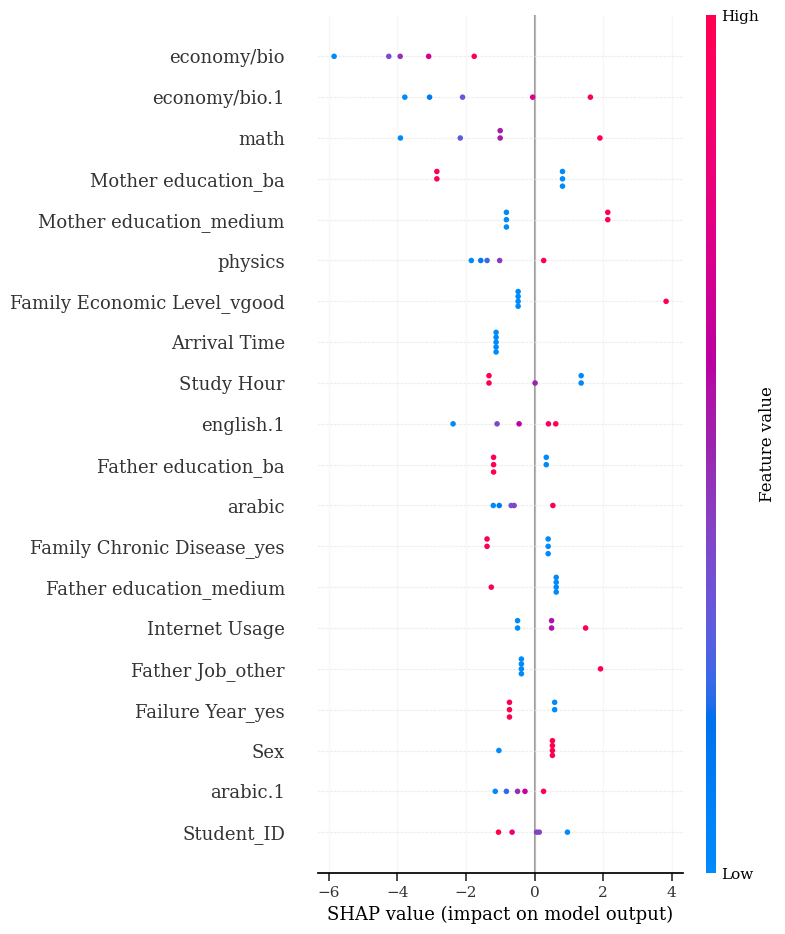

In [ ]:
import shap
import lime
import lime.lime_tabular
import numpy as np

# Step 1: Create a SHAP explainer object
explainer = shap.Explainer(lr_model, X_train)

# Step 2: Compute SHAP values
shap_values = explainer.shap_values(X_test)

# Step 3: Visualize SHAP summary plot
shap.summary_plot(shap_values, X_test, feature_names=X_all.columns)

# Step 4: Create a LIME explainer object
explainer_lime = lime.lime_tabular.LimeTabularExplainer(X_train, mode="regression", feature_names=X_all.columns)

# Step 5: Explain an instance using LIME
exp = explainer_lime.explain_instance(X_test[1], lr_model.predict, num_features=10)




# Step 6: Visualize the explanation
exp.show_in_notebook()





<html>
<body>
    <span style="color: green; font-weight: bold; font-size: 20px;">Random Forest</span>
</body>
</html>




In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Step 2: Model Training
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Step 3: Model Evaluation
y_pred_rf = rf_model.predict(X_test)
mse_rf = mean_squared_error(y_test, y_pred_rf)

# Calculate Mean Absolute Percentage Error (MAPE)
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_rf = mean_absolute_percentage_error(y_test, y_pred_rf)

# Calculate Mean Absolute Error (MAE)
mae_rf = mean_absolute_error(y_test, y_pred_rf)

# Calculate R-squared
r2_rf = r2_score(y_test, y_pred_rf)

# Calculate Coefficient of Determination (COD)
def coefficient_of_determination(y_true, y_pred):
    y_true_mean = np.mean(y_true)
    total_sum_of_squares = np.sum((y_true - y_true_mean)**2)
    residual_sum_of_squares = np.sum((y_true - y_pred)**2)
    cod = 1 - (residual_sum_of_squares / total_sum_of_squares)
    return cod

cod_rf = coefficient_of_determination(y_test, y_pred_rf)

# Calculate Coefficient of Determination (COD)
def coefficient_of_determination(y_true, y_pred):
    y_true_mean = np.mean(y_true)
    total_sum_of_squares = np.sum((y_true - y_true_mean)**2)
    residual_sum_of_squares = np.sum((y_true - y_pred)**2)
    cod = 1 - (residual_sum_of_squares / total_sum_of_squares)
    return cod

cod_rf = coefficient_of_determination(y_test, y_pred_rf)

print(f'Random Forest MSE: {mse_rf}')


# Calculate Root Mean Squared Error (RMSE)
rmse_rf = np.sqrt(mean_squared_error(y_test, y_pred_rf))

# Step 4: Make Predictions
# For example, to predict the first 5 samples in the test set
predictions_rf = rf_model.predict(X_test[:5])
print(f'Predictions (Random Forest): {predictions_rf}')
print(f'Mean Absolute Percentage Error (MAPE): {mape_rf:.2f}%')
print(f'Mean Absolute Error (MAE): {mae_rf}')
print(f'R-squared: {r2_rf}')
print(f'Coefficient of Determination (COD): {cod_rf}')
print(f'Root Mean Squared Error (RMSE): {rmse_rf}')


Random Forest MSE: 27.571039999999982
Predictions (Random Forest): [52.85 54.39 49.23 58.89 51.66]
Mean Absolute Percentage Error (MAPE): 9.83%
Mean Absolute Error (MAE): 4.447999999999999
R-squared: 0.32157874015748067
Coefficient of Determination (COD): 0.32157874015748067
Root Mean Squared Error (RMSE): 5.250813270342031


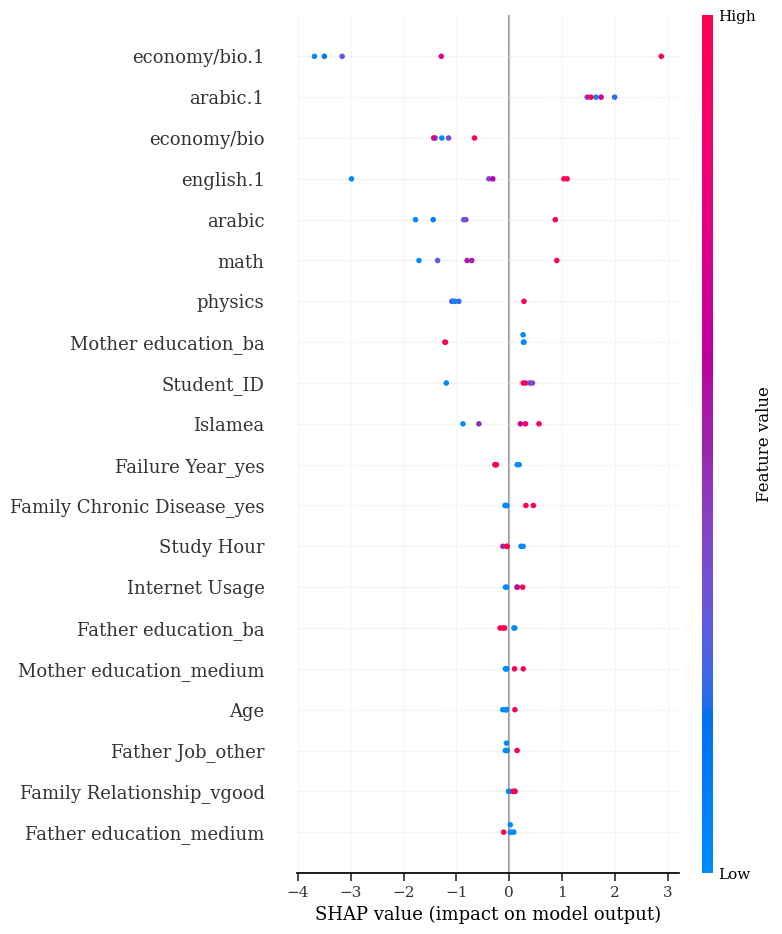

In [ ]:
import shap
import lime
import lime.lime_tabular
import numpy as np

# Step 1: Create a SHAP explainer object
explainer_rf = shap.Explainer(rf_model, X_train)

# Step 2: Compute SHAP values
shap_values_rf = explainer_rf.shap_values(X_test)

# Step 3: Visualize SHAP summary plot
shap.summary_plot(shap_values_rf, X_test, feature_names=X_all.columns)

# Step 4: Create a LIME explainer object
explainer_lime_rf = lime.lime_tabular.LimeTabularExplainer(X_train, mode="regression", feature_names=X_all.columns)

# Step 5: Explain an instance using LIME
exp_rf = explainer_lime_rf.explain_instance(X_test[0], rf_model.predict, num_features=10)

# Step 6: Visualize the explanation
exp_rf.show_in_notebook()



<html>
<body>
    <span style="color: green; font-weight: bold; font-size: 20px;">Support Vector Machine (SVM)</span>
</body>
</html>



In [ ]:
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

# Step 1: Data Preprocessing (Scaling for SVM)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Step 2: Model Training
svm_model = SVR(kernel='linear')
svm_model.fit(X_train_scaled, y_train)

# Step 3: Model Evaluation
y_pred_svm = svm_model.predict(X_test_scaled)
mse_svm = mean_squared_error(y_test, y_pred_svm)
print(f'SVM MSE: {mse_svm}')

# Calculate Mean Absolute Percentage Error (MAPE)
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_svm = mean_absolute_percentage_error(y_test, y_pred_svm)

# Calculate Mean Absolute Error (MAE)
mae_svm = mean_absolute_error(y_test, y_pred_svm)

# Calculate R-squared
r2_svm = r2_score(y_test, y_pred_svm)

# Calculate Root Mean Squared Error (RMSE)
rmse_svm = np.sqrt(mean_squared_error(y_test, y_pred_svm))

# Step 4: Make Predictions
# For example, to predict the first 5 samples in the test set
predictions_svm = svm_model.predict(X_test_scaled[:5])
print(f'Predictions (SVM): {predictions_svm}')

# Print the metrics
print(f'Mean Absolute Percentage Error (MAPE): {mape_svm:.2f}%')
print(f'Mean Absolute Error (MAE): {mae_svm}')
print(f'R-squared: {r2_svm}')
print(f'Root Mean Squared Error (RMSE): {rmse_svm}')


SVM MSE: 30.267716218984653
Predictions (SVM): [46.89783654 52.13834464 47.23457529 47.63614796 44.63342496]
Mean Absolute Percentage Error (MAPE): 8.19%
Mean Absolute Error (MAE): 4.239134222323793
R-squared: 0.2552235182336453
Root Mean Squared Error (RMSE): 5.501610329620288


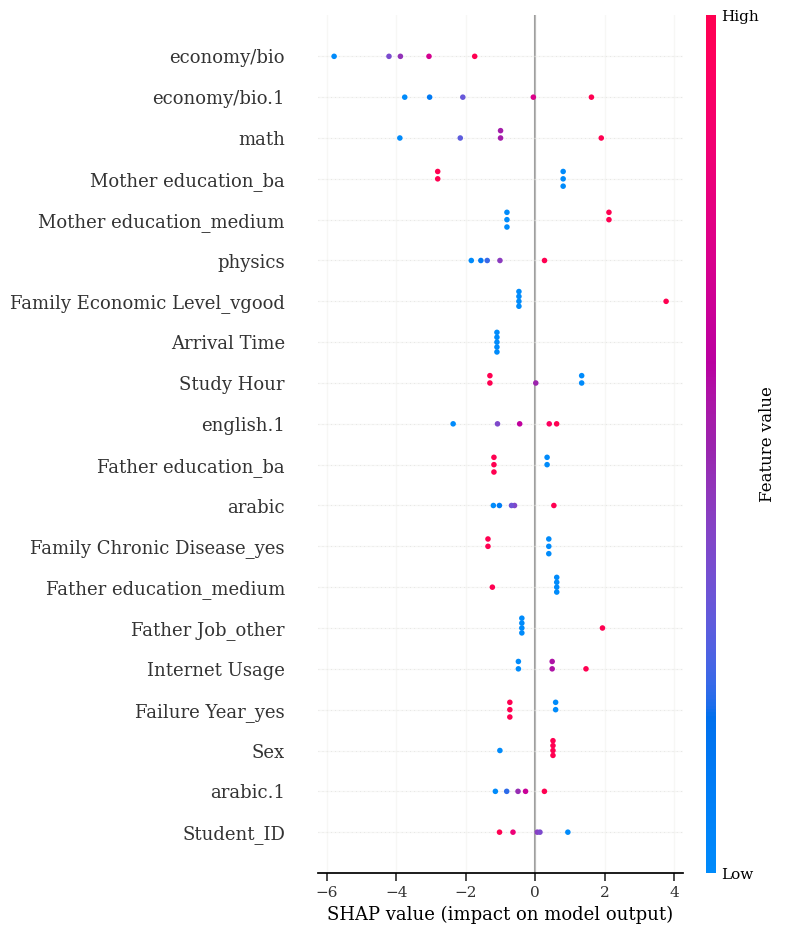

In [ ]:
import shap
import lime
import lime.lime_tabular

# Step 4: Create a SHAP explainer object
explainer_svm = shap.Explainer(svm_model, X_train)

# Step 5: Compute SHAP values
shap_values_svm = explainer_svm.shap_values(X_test)

# Step 6: Visualize SHAP summary plot
shap.summary_plot(shap_values_svm, X_test, feature_names=X_all.columns)

# Step 7: Create a LIME explainer object
explainer_lime_svm = lime.lime_tabular.LimeTabularExplainer(X_train, mode="regression", feature_names=X_all.columns)

# Step 8: Explain an instance using LIME
exp_svm = explainer_lime_svm.explain_instance(X_test_scaled[0], svm_model.predict, num_features=10)

# Step 9: Visualize the explanation
exp_svm.show_in_notebook()



<html>
<body>
    <span style="color: green; font-weight: bold; font-size: 20px;">k-Nearest Neighbors (KNN)</span>
</body>
</html>



In [ ]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Step 2: Model Training
knn_model = KNeighborsRegressor(n_neighbors=5)
knn_model.fit(X_train, y_train)

# Step 3: Model Evaluation
y_pred_knn = knn_model.predict(X_test)
mse_knn = mean_squared_error(y_test, y_pred_knn)
print(f'KNN MSE: {mse_knn}')

# Calculate Mean Absolute Percentage Error (MAPE)
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_knn = mean_absolute_percentage_error(y_test, y_pred_knn)

# Calculate Mean Absolute Error (MAE)
mae_knn = mean_absolute_error(y_test, y_pred_knn)

# Calculate R-squared
r2_knn = r2_score(y_test, y_pred_knn)

# Calculate Coefficient of Determination (COD)
def coefficient_of_determination(y_true, y_pred):
    y_true_mean = np.mean(y_true)
    total_sum_of_squares = np.sum((y_true - y_true_mean)**2)
    residual_sum_of_squares = np.sum((y_true - y_pred)**2)
    cod = 1 - (residual_sum_of_squares / total_sum_of_squares)
    return cod

cod_knn = coefficient_of_determination(y_test, y_pred_knn)

# Calculate Root Mean Squared Error (RMSE)
rmse_knn = np.sqrt(mean_squared_error(y_test, y_pred_knn))

# Print the metrics
print(f'Mean Absolute Percentage Error (MAPE): {mape_knn:.2f}%')
print(f'Mean Absolute Error (MAE): {mae_knn}')
print(f'R-squared: {r2_knn}')
print(f'Coefficient of Determination (COD): {cod_knn}')
print(f'Root Mean Squared Error (RMSE): {rmse_knn}')


KNN MSE: 96.17600000000002
Mean Absolute Percentage Error (MAPE): 12.96%
Mean Absolute Error (MAE): 6.720000000000001
R-squared: -1.366535433070867
Coefficient of Determination (COD): -1.366535433070867
Root Mean Squared Error (RMSE): 9.806936320788466




<html>
<body>
    <span style="color: green; font-weight: bold; font-size: 20px;">Gradient Boosting</span>
</body>
</html>




In [ ]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

# Step 2: Model Training
gb_model = GradientBoostingRegressor(n_estimators=100, random_state=42)
gb_model.fit(X_train, y_train)

# Step 3: Model Evaluation
y_pred_gb = gb_model.predict(X_test)
mse_gb = mean_squared_error(y_test, y_pred_gb)
print(f'Gradient Boosting MSE: {mse_gb}')

# Calculate Mean Absolute Percentage Error (MAPE)
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_gb = mean_absolute_percentage_error(y_test, y_pred_gb)

# Calculate Mean Absolute Error (MAE)
mae_gb = mean_absolute_error(y_test, y_pred_gb)

# Calculate R-squared
r2_gb = r2_score(y_test, y_pred_gb)

# Calculate Coefficient of Determination (COD)
def coefficient_of_determination(y_true, y_pred):
    y_true_mean = np.mean(y_true)
    total_sum_of_squares = np.sum((y_true - y_true_mean)**2)
    residual_sum_of_squares = np.sum((y_true - y_pred)**2)
    cod = 1 - (residual_sum_of_squares / total_sum_of_squares)
    return cod

cod_gb = coefficient_of_determination(y_test, y_pred_gb)

# Calculate Root Mean Squared Error (RMSE)
rmse_gb = np.sqrt(mean_squared_error(y_test, y_pred_gb))

# Print the metrics
print(f'Mean Absolute Percentage Error (MAPE): {mape_gb:.2f}%')
print(f'Mean Absolute Error (MAE): {mae_gb}')
print(f'R-squared: {r2_gb}')
print(f'Coefficient of Determination (COD): {cod_gb}')
print(f'Root Mean Squared Error (RMSE): {rmse_gb}')


Gradient Boosting MSE: 77.18877877689866
Mean Absolute Percentage Error (MAPE): 16.70%
Mean Absolute Error (MAE): 7.8594658654154745
R-squared: -0.8993301864394354
Coefficient of Determination (COD): -0.8993301864394354
Root Mean Squared Error (RMSE): 8.78571447162373


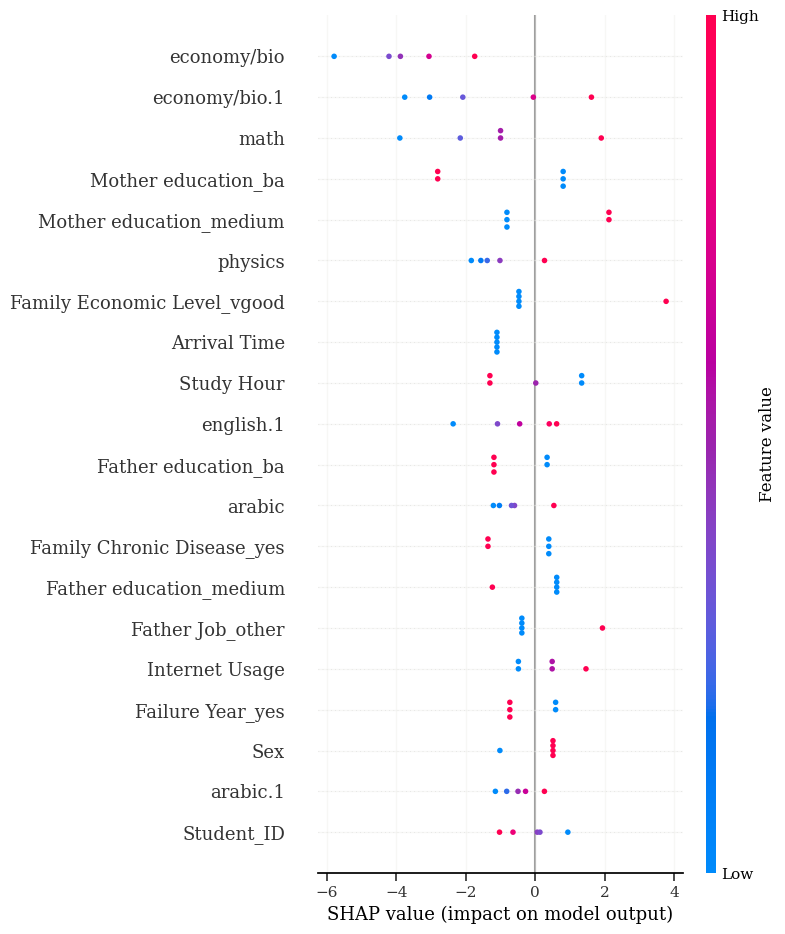

In [ ]:
import shap
import lime
import lime.lime_tabular


# Step 1: Create a SHAP explainer object
explainer_gb = shap.Explainer(gb_model, X_train_scaled)

# Step 2: Compute SHAP values
shap_values_gb = explainer_gb.shap_values(X_test_scaled)

# Step 3: Visualize SHAP summary plot
shap.summary_plot(shap_values_svm, X_test_scaled, feature_names=X_all.columns)

# Step 4: Create a LIME explainer object
explainer_lime_gb = lime.lime_tabular.LimeTabularExplainer(X_train_scaled, mode="regression", feature_names=X_all.columns)

# Step 5: Explain an instance using LIME
exp_gb = explainer_lime_gb.explain_instance(X_test_scaled[0], gb_model.predict, num_features=10)

# Step 6: Visualize the explanation
exp_gb.show_in_notebook()

In [ ]:
import torch
import numpy as np

# Convert X_train to a compatible data type (numpy array)
X_train_array = X_train.astype(np.float32)
y_train_array = y_train.astype(np.float32).values  # Convert y_train to a NumPy array
X_test_array = X_test.astype(np.float32)
y_test_array = y_test.astype(np.float32).values  # Convert y_test to a NumPy array

print(X_train_array.shape)
print(y_train_array.shape)

# Convert numpy arrays to PyTorch tensors
X_train_tensor = torch.tensor(X_train_array, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train_array, dtype=torch.float32)
X_test_tensor = torch.tensor(X_test_array, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test_array, dtype=torch.float32)


(18, 37)
(18,)


In [ ]:
class GNN(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(GNN, self).__init__()
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, output_dim)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.fc2(x)
        return x

# Instantiate the model
input_dim = X_train.shape[1]  # Number of features
hidden_dim = 64  # Hidden layer size
output_dim = 1  # Output size
model = GNN(input_dim, hidden_dim, output_dim)


In [ ]:
# Define loss function and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Convert data to DataLoader for batching
train_data = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_data, batch_size=64, shuffle=True)

In [ ]:
# Training the model
from sklearn.metrics import r2_score

epochs = 500
train_losses = []
train_accuracies = []

for epoch in range(epochs):
    model.train()
    running_loss = 0.0
    y_true = []
    y_pred = []

    for inputs, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

        # Store predictions for computing accuracy
        y_true.extend(labels.numpy())
        y_pred.extend(outputs.squeeze().detach().numpy())

    train_losses.append(running_loss / len(train_loader))

    # Compute R-squared
    r2 = r2_score(y_true, y_pred)
    train_accuracies.append(r2)

    print(f'Epoch {epoch+1}/{epochs}, Loss: {train_losses[-1]}, Accuracy: {train_accuracies[-1]}')




Epoch 1/500, Loss: 3622.7861328125, Accuracy: -12.863356832217109
Epoch 2/500, Loss: 3618.772216796875, Accuracy: -12.847997136498677
Epoch 3/500, Loss: 3614.8076171875, Accuracy: -12.83282530403063
Epoch 4/500, Loss: 3610.87109375, Accuracy: -12.817760807161921
Epoch 5/500, Loss: 3606.9521484375, Accuracy: -12.802764705595932
Epoch 6/500, Loss: 3603.050048828125, Accuracy: -12.787832976842845
Epoch 7/500, Loss: 3599.173095703125, Accuracy: -12.772996879541294
Epoch 8/500, Loss: 3595.293212890625, Accuracy: -12.758148649891414
Epoch 9/500, Loss: 3591.439697265625, Accuracy: -12.743402150306668
Epoch 10/500, Loss: 3587.59912109375, Accuracy: -12.728707592743703
Epoch 11/500, Loss: 3583.7607421875, Accuracy: -12.71401707064633
Epoch 12/500, Loss: 3579.92431640625, Accuracy: -12.69933521636573
Epoch 13/500, Loss: 3576.096923828125, Accuracy: -12.684690239233744
Epoch 14/500, Loss: 3572.28173828125, Accuracy: -12.670090807067144
Epoch 15/500, Loss: 3568.458740234375, Accuracy: -12.65546175

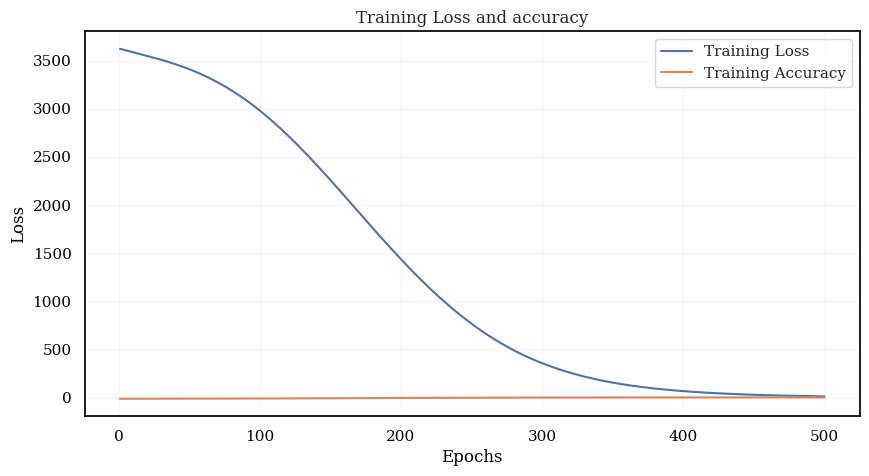

In [ ]:
# Plot training loss
plt.figure(figsize=(10, 5))
plt.plot(range(1, epochs + 1), train_losses, label='Training Loss')
plt.plot(range(1, epochs + 1), train_accuracies, label='Training Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss and accuracy')
plt.legend()
plt.show()

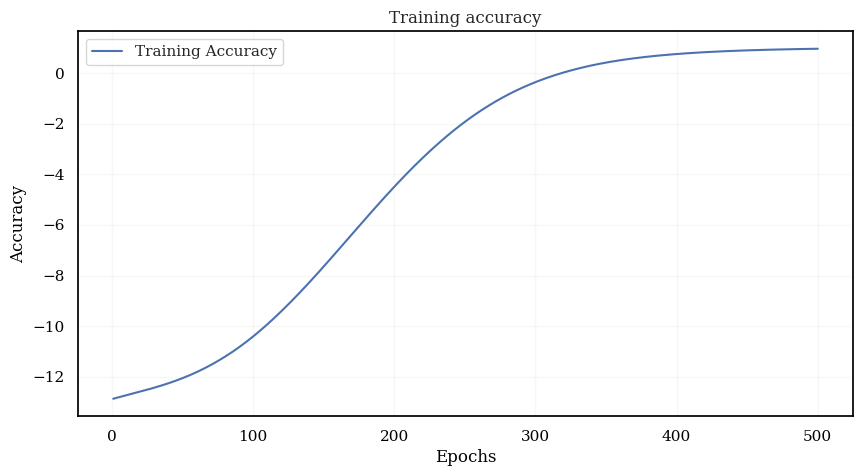

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(range(1, epochs + 1), train_accuracies, label='Training Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Training accuracy')
plt.legend()
plt.show()

Test Loss: 687.1148681640625
Mean Squared Error (MSE): 687.1148681640625
Root Mean Squared Error (RMSE): 26.212875999479007
Mean Absolute Error (MAE): 23.844173431396484
Coefficient of Determination (COD): -83.75433349609375
Mean Absolute Percentage Error (MAPE): 47.2167044878006


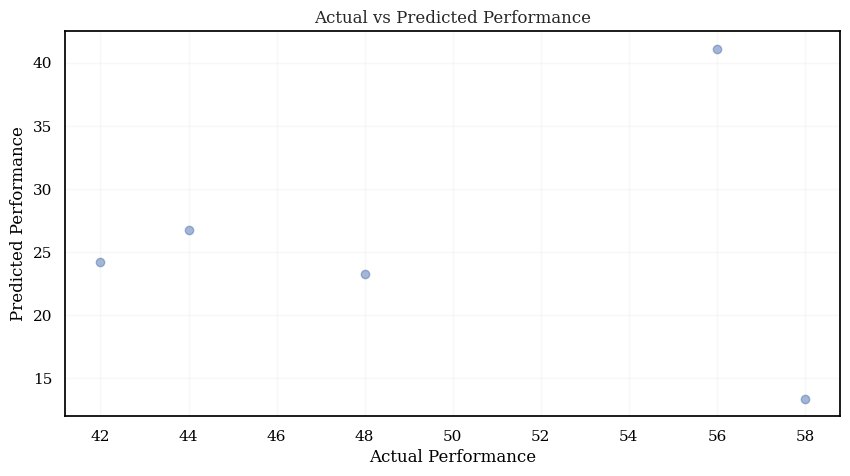

In [ ]:
# Define MAPE and COD functions
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

def coefficient_of_determination(y_true, y_pred):
    y_true_mean = np.mean(y_true)
    total_sum_of_squares = np.sum((y_true - y_true_mean)**2)
    residual_sum_of_squares = np.sum((y_true - y_pred)**2)
    cod = 1 - (residual_sum_of_squares / total_sum_of_squares)
    return cod

# Evaluation
model.eval()
with torch.no_grad():
    predicted = model(X_test_tensor)
    test_loss = criterion(predicted.squeeze(), y_test_tensor)
    print(f'Test Loss: {test_loss.item()}')


    # Compute additional metrics
    mse = mean_squared_error(y_test_tensor.numpy(), predicted.numpy())
    rmse = math.sqrt(mse)
    mae = mean_absolute_error(y_test_tensor.numpy(), predicted.numpy())
    cod = coefficient_of_determination(y_test_tensor.numpy(), predicted.numpy())
    mape = mean_absolute_percentage_error(y_test_tensor.numpy(), predicted.numpy())

    # Print or display the calculated metrics
    print(f'Mean Squared Error (MSE): {mse}')
    print(f'Root Mean Squared Error (RMSE): {rmse}')
    print(f'Mean Absolute Error (MAE): {mae}')
    print(f'Coefficient of Determination (COD): {cod}')
    print(f'Mean Absolute Percentage Error (MAPE): {mape}')

    # Visualize predicted vs actual
    plt.figure(figsize=(10, 5))
    plt.scatter(y_test, predicted, alpha=0.5)
    plt.xlabel('Actual Performance')
    plt.ylabel('Predicted Performance')
    plt.title('Actual vs Predicted Performance')
    plt.show()

In [ ]:
# Print final loss and accuracy
final_loss = train_losses[-1]
final_accuracy = train_accuracies[-1]

print(f'Final Loss: {final_loss}')
print(f'Final Accuracy: {final_accuracy}')


Final Loss: 11.800973892211914
Final Accuracy: 0.9548410841116792


In [ ]:
# Save the trained model
torch.save(model.state_dict(), 'student_performance_model.pkl')

# Load the saved model
loaded_model = GNN(input_dim, hidden_dim, output_dim)
loaded_model.load_state_dict(torch.load('student_performance_model.pkl'))
loaded_model.eval()

GNN(
  (fc1): Linear(in_features=37, out_features=64, bias=True)
  (fc2): Linear(in_features=64, out_features=1, bias=True)
  (relu): ReLU()
)

Epoch 1/500, Loss: 11.589617729187012, Accuracy: 0.9556498847580267
Epoch 2/500, Loss: 11.589615821838379, Accuracy: 0.9556498847580267
Epoch 3/500, Loss: 11.589615821838379, Accuracy: 0.9556498847580267
Epoch 4/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 5/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 6/500, Loss: 11.589617729187012, Accuracy: 0.9556498847580267
Epoch 7/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 8/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 9/500, Loss: 11.589617729187012, Accuracy: 0.9556498847580267
Epoch 10/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 11/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 12/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 13/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 14/500, Loss: 11.589617729187012, Accuracy: 0.9556498847580267
Epoch 15/500, Loss: 11.589616775512695, Acc

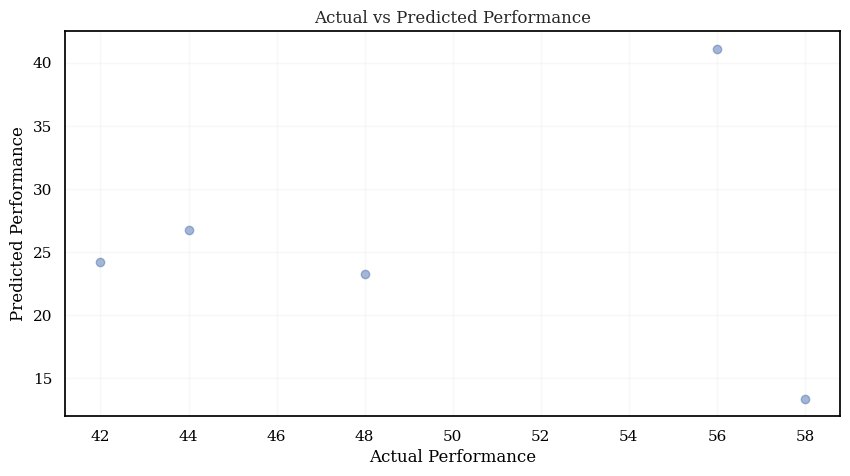

In [ ]:
import torch.optim as optim
from sklearn.metrics import mean_squared_error, precision_score, recall_score, f1_score, classification_report
import math

# Define the RNN model
class RNN(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(RNN, self).__init__()
        self.rnn = nn.RNN(input_dim, hidden_dim, batch_first=True)
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        out, _ = self.rnn(x)
        out = self.fc(out[:, -1, :])
        return out

# Instantiate the model
rnn_model = RNN(input_dim, hidden_dim, output_dim)

# Define loss function and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(rnn_model.parameters(), lr=0.001)

# Convert data to DataLoader for batching
train_data = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_data, batch_size=64, shuffle=True)

# Training the model
from sklearn.metrics import r2_score

epochs = 500
train_losses = []
train_accuracies = []

for epoch in range(epochs):
    model.train()
    running_loss = 0.0
    y_true = []
    y_pred = []

    for inputs, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

        # Store predictions for computing accuracy
        y_true.extend(labels.numpy())
        y_pred.extend(outputs.squeeze().detach().numpy())

    train_losses.append(running_loss / len(train_loader))

    # Compute R-squared
    r2 = r2_score(y_true, y_pred)
    train_accuracies.append(r2)

    print(f'Epoch {epoch+1}/{epochs}, Loss: {train_losses[-1]}, Accuracy: {train_accuracies[-1]}')
threshold = 0.5
# Evaluation
model.eval()
with torch.no_grad():
    predicted = model(X_test_tensor)
    test_loss = criterion(predicted.squeeze(), y_test_tensor)
    print(f'Test Loss: {test_loss.item()}')

    def mean_absolute_percentage_error(y_true, y_pred):
        y_true, y_pred = np.array(y_true), np.array(y_pred)
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

    def coefficient_of_determination(y_true, y_pred):
        y_true_mean = np.mean(y_true)
        total_sum_of_squares = np.sum((y_true - y_true_mean)**2)
        residual_sum_of_squares = np.sum((y_true - y_pred)**2)
        cod = 1 - (residual_sum_of_squares / total_sum_of_squares)
        return cod

        # Compute additional metrics
    mse = mean_squared_error(y_test_tensor.numpy(), predicted.numpy())
    rmse = math.sqrt(mse)
    mape = mean_absolute_percentage_error(y_test_tensor.numpy(), predicted.numpy())
    cod = coefficient_of_determination(y_test_tensor.numpy(), predicted.numpy())
    mae = mean_absolute_error(y_test_tensor.numpy(), predicted.numpy())
    print(f'Mean Squared Error (MSE): {mse}')
    print(f'Root Mean Squared Error (RMSE): {rmse}')
    print(f'Mean Absolute Error (MAE): {mae}')
    print(f'Coefficient of Determination (COD): {cod}')
    print(f'Mean Absolute Percentage Error (MAPE): {mape}')

    # Visualize predicted vs actual
    plt.figure(figsize=(10, 5))
    plt.scatter(y_test, predicted, alpha=0.5)
    plt.xlabel('Actual Performance')
    plt.ylabel('Predicted Performance')
    plt.title('Actual vs Predicted Performance')
    plt.show()

    # Print final loss and accuracy
final_loss = train_losses[-1]
final_accuracy = train_accuracies[-1]

# Save the trained model
torch.save(model.state_dict(), 'student_performance_model_RNN.pkl')



Epoch 1/500, Loss: 3601.822265625, Accuracy: -12.78313389125886
Epoch 2/500, Loss: 3588.397705078125, Accuracy: -12.731763335526763
Epoch 3/500, Loss: 3573.952880859375, Accuracy: -12.676485813286737
Epoch 4/500, Loss: 3557.1787109375, Accuracy: -12.612295387860367
Epoch 5/500, Loss: 3537.42333984375, Accuracy: -12.53669881625077
Epoch 6/500, Loss: 3514.4453125, Accuracy: -12.448768148983692
Epoch 7/500, Loss: 3488.3056640625, Accuracy: -12.348738909326011
Epoch 8/500, Loss: 3459.232177734375, Accuracy: -12.237482913555318
Epoch 9/500, Loss: 3427.509521484375, Accuracy: -12.116089101569095
Epoch 10/500, Loss: 3393.426513671875, Accuracy: -11.985664475541695
Epoch 11/500, Loss: 3357.259033203125, Accuracy: -11.847261915695725
Epoch 12/500, Loss: 3319.271484375, Accuracy: -11.701893597251964
Epoch 13/500, Loss: 3279.71630859375, Accuracy: -11.550527396140073
Epoch 14/500, Loss: 3238.8330078125, Accuracy: -11.394079674468465
Epoch 15/500, Loss: 3196.8447265625, Accuracy: -11.2334018376228

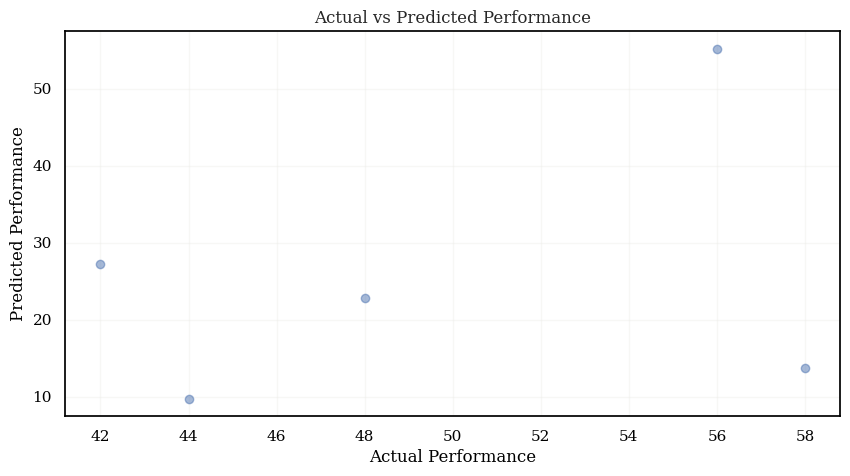

Final Loss: 13.526713371276855
Final Accuracy: 0.9482371718364582


In [ ]:
import torch.optim as optim
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np

# Define the LSTM model
class LSTM(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(LSTM, self).__init__()
        self.lstm = nn.LSTM(input_dim, hidden_dim, batch_first=True)
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        out, _ = self.lstm(x)
        out = self.fc(out[:, -1, :])  # Predict only from the last time step
        return out

# Instantiate the model
lstm_model = LSTM(input_dim, hidden_dim, output_dim)

# Define loss function and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(lstm_model.parameters(), lr=0.01)

# Convert data to DataLoader for batching
train_data = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_data, batch_size=64, shuffle=True)

# Training the model
epochs = 500
train_losses = []
train_accuracies = []

for epoch in range(epochs):
    lstm_model.train()
    running_loss = 0.0
    y_true = []
    y_pred = []

    for inputs, labels in train_loader:
        optimizer.zero_grad()
        inputs = inputs.unsqueeze(1)  # Add a dummy sequence length dimension
        outputs = lstm_model(inputs)
        loss = criterion(outputs.squeeze(), labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

        # Store predictions for computing accuracy
        y_true.extend(labels.numpy())
        y_pred.extend(outputs.squeeze().detach().numpy())

    train_losses.append(running_loss / len(train_loader))

    # Compute R-squared
    r2 = r2_score(y_true, y_pred)
    train_accuracies.append(r2)

    print(f'Epoch {epoch+1}/{epochs}, Loss: {train_losses[-1]}, Accuracy: {train_accuracies[-1]}')

# Evaluation
lstm_model.eval()
with torch.no_grad():
    predicted = lstm_model(X_test_tensor.unsqueeze(1))  # Add a dummy sequence length dimension
    test_loss = criterion(predicted.squeeze(), y_test_tensor)
    print(f'Test Loss: {test_loss.item()}')

    # Calculate additional evaluation metrics
    mse = mean_squared_error(y_test_tensor, predicted)
    rmse = np.sqrt(mse)
    r_squared = r2_score(y_test_tensor, predicted)
        # Calculate MAPE
    mape = mean_absolute_percentage_error(y_test_tensor.numpy(), predicted.numpy())

    # Calculate COD
    cod = coefficient_of_determination(y_test_tensor.numpy(), predicted.numpy())


    print(f'MSE: {mse}')
    print(f'RMSE: {rmse}')
    print(f'R-squared: {r_squared}')
    print(f'MAPE: {mape:.2f}%')
    print(f'COD: {cod}')

    # Visualize predicted vs actual
    plt.figure(figsize=(10, 5))
    plt.scatter(y_test, predicted.numpy(), alpha=0.5)
    plt.xlabel('Actual Performance')
    plt.ylabel('Predicted Performance')
    plt.title('Actual vs Predicted Performance')
    plt.show()

# Print final loss and accuracy
final_loss = train_losses[-1]
final_accuracy = train_accuracies[-1]

print(f'Final Loss: {final_loss}')
print(f'Final Accuracy: {final_accuracy}')

# Save the trained model
torch.save(lstm_model.state_dict(), 'student_performance_model_LSTM.pkl')


Epoch 1/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 2/500, Loss: 11.589617729187012, Accuracy: 0.9556498847580267
Epoch 3/500, Loss: 11.589617729187012, Accuracy: 0.9556498847580267
Epoch 4/500, Loss: 11.589615821838379, Accuracy: 0.9556498847580267
Epoch 5/500, Loss: 11.589615821838379, Accuracy: 0.9556498847580267
Epoch 6/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 7/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 8/500, Loss: 11.589615821838379, Accuracy: 0.9556498847580267
Epoch 9/500, Loss: 11.589617729187012, Accuracy: 0.9556498847580267
Epoch 10/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 11/500, Loss: 11.589615821838379, Accuracy: 0.9556498847580267
Epoch 12/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 13/500, Loss: 11.589616775512695, Accuracy: 0.9556498847580267
Epoch 14/500, Loss: 11.589614868164062, Accuracy: 0.9556498847580267
Epoch 15/500, Loss: 11.589617729187012, Acc

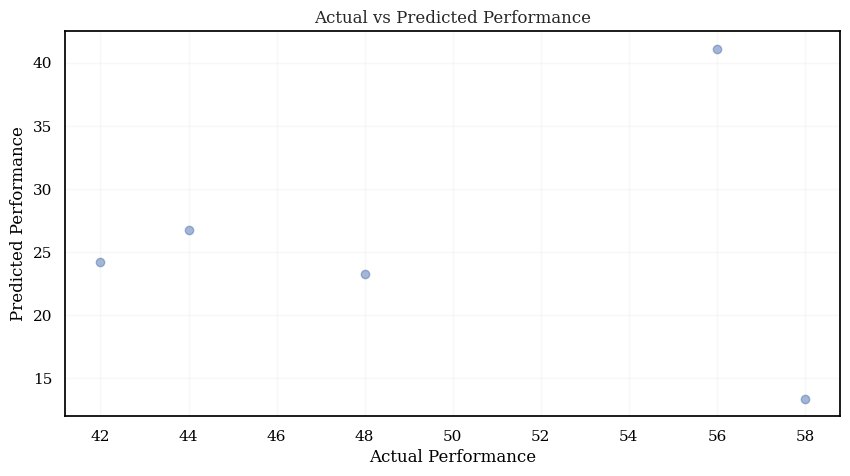

Final Loss: 11.589616775512695
Final Accuracy: 0.9556498847580267
Mean Squared Error (MSE): 687.1148681640625
Mean Absolute Error (MAE): 23.844173431396484
R-squared: -15.907354165849693
Coefficient of Determination (COD): -83.75433349609375
Root Mean Squared Error (RMSE): 26.212875366210938
Mean Absolute Percentage Error (MAPE): 47.2167044878006


In [ ]:
import torch.optim as optim
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Define the CNN model
class CNN(nn.Module):
    def __init__(self, input_dim, output_dim):
        super(CNN, self).__init__()
        self.conv1 = nn.Conv1d(in_channels=input_dim, out_channels=16, kernel_size=3)
        self.pool = nn.MaxPool1d(kernel_size=2)
        self.conv2 = nn.Conv1d(in_channels=16, out_channels=32, kernel_size=3)
        self.fc1 = nn.Linear(32 * 6, 64)
        self.fc2 = nn.Linear(64, output_dim)

    def forward(self, x):
        x = self.pool(nn.functional.relu(self.conv1(x)))
        x = self.pool(nn.functional.relu(self.conv2(x)))
        x = x.view(-1, 32 * 6)
        x = nn.functional.relu(self.fc1(x))
        x = self.fc2(x)
        return x

# Instantiate the model
cnn_model = CNN(input_dim, output_dim)

# Define loss function and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(cnn_model.parameters(), lr=0.001)

# Convert data to DataLoader for batching
train_data = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_data, batch_size=64, shuffle=True)

# Training the model
from sklearn.metrics import r2_score

epochs = 500
train_losses = []
train_accuracies = []

for epoch in range(epochs):
    model.train()
    running_loss = 0.0
    y_true = []
    y_pred = []

    for inputs, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs.squeeze(), labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

        # Store predictions for computing accuracy
        y_true.extend(labels.numpy())
        y_pred.extend(outputs.squeeze().detach().numpy())

    train_losses.append(running_loss / len(train_loader))

    # Compute R-squared
    r2 = r2_score(y_true, y_pred)
    train_accuracies.append(r2)

    print(f'Epoch {epoch+1}/{epochs}, Loss: {train_losses[-1]}, Accuracy: {train_accuracies[-1]}')

# Evaluation
model.eval()
with torch.no_grad():
    predicted = model(X_test_tensor)
    test_loss = criterion(predicted.squeeze(), y_test_tensor)
    print(f'Test Loss: {test_loss.item()}')

    # Calculate Mean Squared Error (MSE)
    mse_cnn = mean_squared_error(y_test_tensor, predicted)
    # Calculate Mean Absolute Error (MAE)
    mae_cnn = mean_absolute_error(y_test_tensor, predicted)
    # Calculate R-squared
    r2_cnn = r2_score(y_test_tensor, predicted)

    def mean_absolute_percentage_error(y_true, y_pred):
        y_true, y_pred = np.array(y_true), np.array(y_pred)
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

    mape_cnn = mean_absolute_percentage_error(y_test_tensor, predicted)


    # Calculate Coefficient of Determination (COD)
    def coefficient_of_determination(y_true, y_pred):
        y_true_mean = torch.mean(y_true)
        total_sum_of_squares = torch.sum((y_true - y_true_mean)**2)
        residual_sum_of_squares = torch.sum((y_true - y_pred)**2)
        cod = 1 - (residual_sum_of_squares / total_sum_of_squares)
        return cod


    cod_cnn = coefficient_of_determination(y_test_tensor, predicted)
    # Calculate Root Mean Squared Error (RMSE)
    rmse_cnn = np.sqrt(mse_cnn)

    # Visualize predicted vs actual
    plt.figure(figsize=(10, 5))
    plt.scatter(y_test, predicted, alpha=0.5)
    plt.xlabel('Actual Performance')
    plt.ylabel('Predicted Performance')
    plt.title('Actual vs Predicted Performance')
    plt.show()

    # Print final loss and accuracy
final_loss = train_losses[-1]
final_accuracy = train_accuracies[-1]

print(f'Final Loss: {final_loss}')
print(f'Final Accuracy: {final_accuracy}')
print(f'Mean Squared Error (MSE): {mse_cnn}')
print(f'Mean Absolute Error (MAE): {mae_cnn}')
print(f'R-squared: {r2_cnn}')
print(f'Coefficient of Determination (COD): {cod_cnn}')
print(f'Root Mean Squared Error (RMSE): {rmse_cnn}')
print(f'Mean Absolute Percentage Error (MAPE): {mape_cnn}')

# Save the trained model
torch.save(model.state_dict(), 'student_performance_model_CNN.pkl')




In [ ]:
import xgboost as xgb
from sklearn.metrics import mean_squared_error, r2_score

# Instantiate the XGBoost model
xgb_model = xgb.XGBRegressor()

# Fit the model to the training data
xgb_model.fit(X_train, y_train)

# Make predictions
predictions_xgb = xgb_model.predict(X_test)

# Evaluate the model
mse_xgb = mean_squared_error(y_test, predictions_xgb)
print(f'XGBoost MSE: {mse_xgb}')

# Calculate Root Mean Squared Error (RMSE)
rmse_xgb = np.sqrt(mse_xgb)
print(f'XGBoost RMSE: {rmse_xgb}')

# Calculate R-squared
r_squared_xgb = r2_score(y_test, predictions_xgb)
print(f'XGBoost R-squared: {r_squared_xgb}')

# Calculate Mean Absolute Percentage Error (MAPE)
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_xgb = mean_absolute_percentage_error(y_test, predictions_xgb)
print(f'XGBoost MAPE: {mape_xgb:.2f}%')

# Calculate Coefficient of Determination (COD)
def coefficient_of_determination(y_true, y_pred):
    y_true_mean = np.mean(y_true)
    total_sum_of_squares = np.sum((y_true - y_true_mean)**2)
    residual_sum_of_squares = np.sum((y_true - y_pred)**2)
    cod = 1 - (residual_sum_of_squares / total_sum_of_squares)
    return cod

cod_xgb = coefficient_of_determination(y_test, predictions_xgb)
print(f'XGBoost COD: {cod_xgb}')




XGBoost MSE: 61.22690618352499
XGBoost RMSE: 7.82476237233598
XGBoost R-squared: -0.5065675734135087
XGBoost MAPE: 13.59%
XGBoost COD: -0.5065675734135087


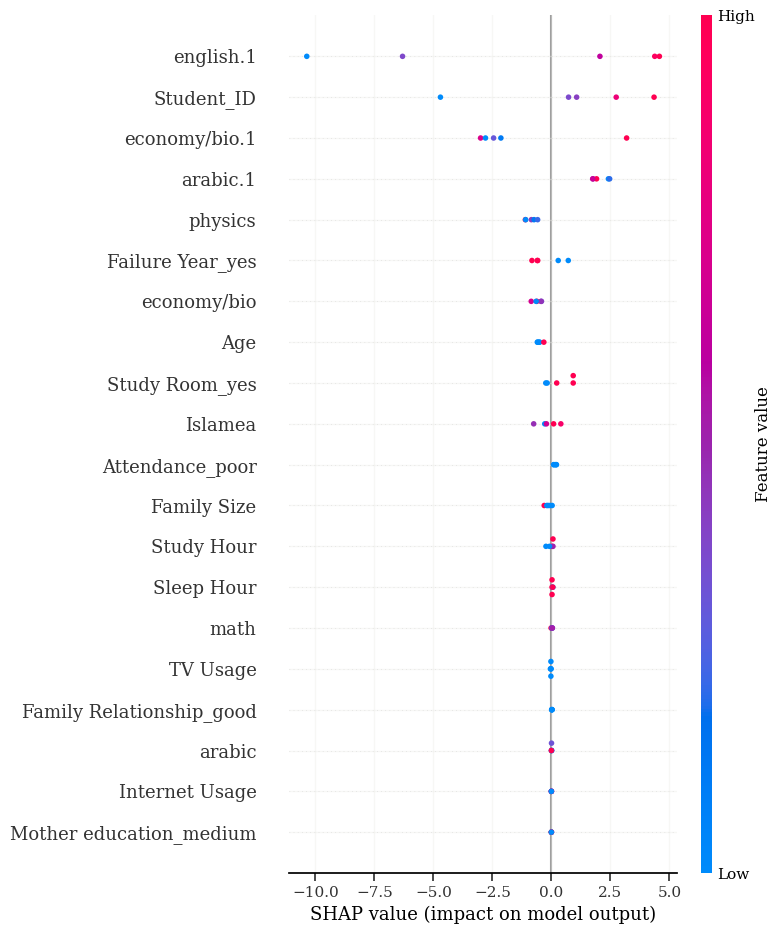

In [ ]:
import shap
import lime
import lime.lime_tabular
import numpy as np

# Step 1: Create a SHAP explainer object
explainer_shap = shap.Explainer(xgb_model, X_train)

# Step 2: Compute SHAP values
shap_values = explainer_shap.shap_values(X_test)

# Step 3: Visualize SHAP summary plot
shap.summary_plot(shap_values, X_test, feature_names=X_all.columns)

# Step 4: Create a LIME explainer object
explainer_lime = lime.lime_tabular.LimeTabularExplainer(X_train, mode="regression", feature_names=X_all.columns)

# Step 5: Explain an instance using LIME
exp = explainer_lime.explain_instance(X_test[1], xgb_model.predict, num_features=10)

# Step 6: Visualize the explanation
exp.show_in_notebook()


In [ ]:
from sklearn.ensemble import AdaBoostRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Instantiate the AdaBoost model
adaboost_model = AdaBoostRegressor()

# Fit the model to the training data
adaboost_model.fit(X_train, y_train)

# Make predictions
predictions_adaboost = adaboost_model.predict(X_test)

# Evaluate the model
mse_adaboost = mean_squared_error(y_test, predictions_adaboost)
print(f'AdaBoost MSE: {mse_adaboost}')

# Calculate Root Mean Squared Error (RMSE)
rmse_adaboost = np.sqrt(mse_adaboost)
print(f'AdaBoost RMSE: {rmse_adaboost}')

# Calculate R-squared
r_squared_adaboost = r2_score(y_test, predictions_adaboost)
print(f'AdaBoost R-squared: {r_squared_adaboost}')

# Calculate Mean Absolute Percentage Error (MAPE)
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_adaboost = mean_absolute_percentage_error(y_test, predictions_adaboost)
print(f'AdaBoost MAPE: {mape_adaboost:.2f}%')

# Calculate Coefficient of Determination (COD)
def coefficient_of_determination(y_true, y_pred):
    y_true_mean = np.mean(y_true)
    total_sum_of_squares = np.sum((y_true - y_true_mean)**2)
    residual_sum_of_squares = np.sum((y_true - y_pred)**2)
    cod = 1 - (residual_sum_of_squares / total_sum_of_squares)
    return cod

cod_adaboost = coefficient_of_determination(y_test, predictions_adaboost)
print(f'AdaBoost COD: {cod_adaboost}')


AdaBoost MSE: 25.1
AdaBoost RMSE: 5.0099900199501395
AdaBoost R-squared: 0.3823818897637795
AdaBoost MAPE: 9.81%
AdaBoost COD: 0.3823818897637795


In [ ]:
import lime
import lime.lime_tabular
import numpy as np

# Step 1: Create a LIME explainer object
explainer_lime_adaboost = lime.lime_tabular.LimeTabularExplainer(X_train, mode="regression", feature_names=X_all.columns)

# Step 2: Explain an instance using LIME
exp_adaboost = explainer_lime_adaboost.explain_instance(X_test[1], adaboost_model.predict, num_features=10)

# Step 3: Visualize the explanation
exp_adaboost.show_in_notebook()


In [ ]:
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF
from sklearn.metrics import mean_squared_error, r2_score

# Instantiate the Gaussian Process model
kernel = RBF()
gpr_model = GaussianProcessRegressor(kernel=kernel)

# Fit the model to the training data
gpr_model.fit(X_train, y_train)

# Make predictions
predictions_gpr = gpr_model.predict(X_test)

# Evaluate the model
mse_gpr = mean_squared_error(y_test, predictions_gpr)
print(f'GPR MSE: {mse_gpr}')

# Round predictions to the nearest integer
predictions_gpr_rounded = np.round(predictions_gpr).astype(int)

# Calculate Root Mean Squared Error (RMSE)
rmse_gpr = np.sqrt(mse_gpr)
print(f'GPR RMSE: {rmse_gpr}')

# Calculate R-squared
r_squared_gpr = r2_score(y_test, predictions_gpr)
print(f'GPR R-squared: {r_squared_gpr}')

# Calculate Mean Absolute Percentage Error (MAPE)
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape_gpr = mean_absolute_percentage_error(y_test, predictions_gpr)
print(f'GPR MAPE: {mape_gpr:.2f}%')

# Calculate Coefficient of Determination (COD)
def coefficient_of_determination(y_true, y_pred):
    y_true_mean = np.mean(y_true)
    total_sum_of_squares = np.sum((y_true - y_true_mean)**2)
    residual_sum_of_squares = np.sum((y_true - y_pred)**2)
    cod = 1 - (residual_sum_of_squares / total_sum_of_squares)
    return cod

cod_gpr = coefficient_of_determination(y_test, predictions_gpr)
print(f'GPR COD: {cod_gpr}')




GPR MSE: 27.777892110113687
GPR RMSE: 5.2704736134538885
GPR R-squared: 0.3164888752432655
GPR MAPE: 9.35%
GPR COD: 0.3164888752432655


  0%|          | 0/5 [00:00<?, ?it/s]

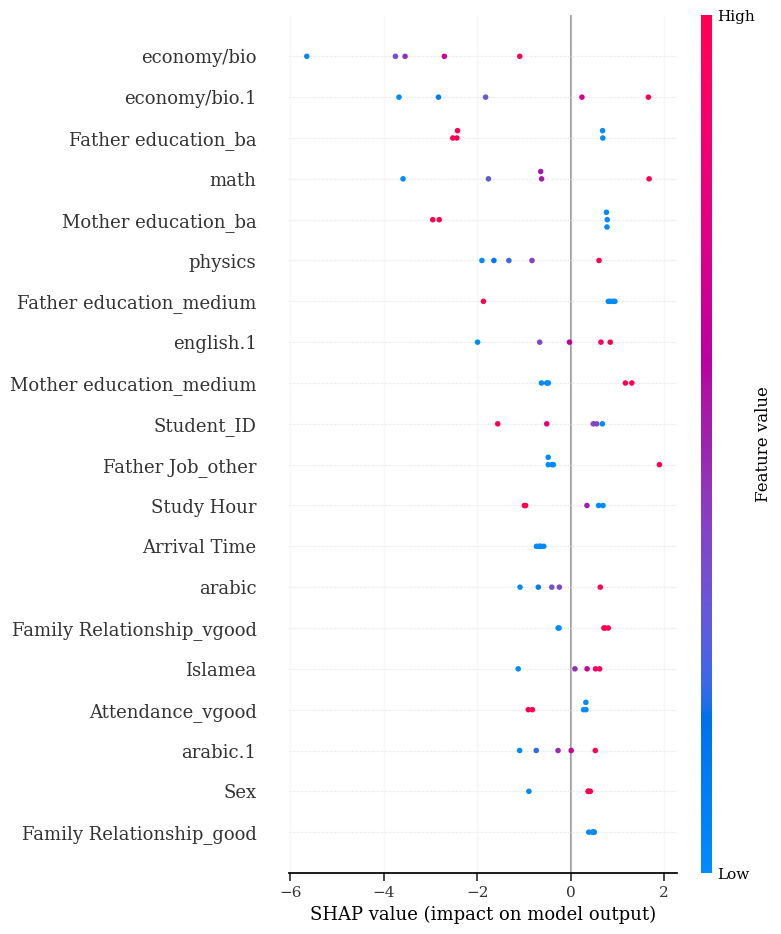

In [ ]:
import shap
import lime
import lime.lime_tabular
import numpy as np

# Define a function to predict using the GaussianProcessRegressor model
def gpr_predict(X):
    return gpr_model.predict(X)

# Step 1: Create a SHAP explainer object
explainer_shap_gpr = shap.KernelExplainer(gpr_predict, X_train)

# Step 2: Compute SHAP values
shap_values_gpr = explainer_shap_gpr.shap_values(X_test)

# Step 3: Visualize SHAP summary plot
shap.summary_plot(shap_values_gpr, X_test, feature_names=X_all.columns)

# Step 4: Create a LIME explainer object
explainer_lime_gpr = lime.lime_tabular.LimeTabularExplainer(X_train, mode="regression", feature_names=X_all.columns)

# Step 5: Explain an instance using LIME
exp_gpr = explainer_lime_gpr.explain_instance(X_test[1], gpr_predict, num_features=10)

# Step 6: Visualize the explanation
exp_gpr.show_in_notebook()


In [ ]:
from sklearn.linear_model import ElasticNet
from sklearn.metrics import precision_score, recall_score, f1_score

# Instantiate the Elastic Net model
elastic_net_model = ElasticNet()

# Fit the model to the training data
elastic_net_model.fit(X_train, y_train)

# Make predictions
predictions_elastic_net = elastic_net_model.predict(X_test)

# Evaluate the model
mse_elastic_net = mean_squared_error(y_test, predictions_elastic_net)
print(f'Elastic Net MSE: {mse_elastic_net}')

# Convert predictions to binary classification if needed
threshold = 0.5  # Define threshold for binary classification
binary_predictions_elastic_net = predictions_elastic_net > threshold

# Calculate Root Mean Squared Error (RMSE)
rmse_elastic_net = np.sqrt(mse_elastic_net)
print(f'Elastic Net RMSE: {rmse_elastic_net}')

# Calculate R-squared
r_squared = r2_score(y_test, predictions_elastic_net)
print(f'R-squared: {r_squared}')

# Calculate Mean Absolute Percentage Error (MAPE)
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape = mean_absolute_percentage_error(y_test, predictions_elastic_net)
print(f'MAPE: {mape:.2f}%')

# Calculate Coefficient of Determination (COD)
def coefficient_of_determination(y_true, y_pred):
    y_true_mean = np.mean(y_true)
    total_sum_of_squares = np.sum((y_true - y_true_mean)**2)
    residual_sum_of_squares = np.sum((y_true - y_pred)**2)
    cod = 1 - (residual_sum_of_squares / total_sum_of_squares)
    return cod

cod = coefficient_of_determination(y_test, predictions_elastic_net)
print(f'COD: {cod}')



Elastic Net MSE: 20.49159316694773
Elastic Net RMSE: 4.5267640944661265
R-squared: 0.4957777271912468
MAPE: 8.73%
COD: 0.4957777271912468


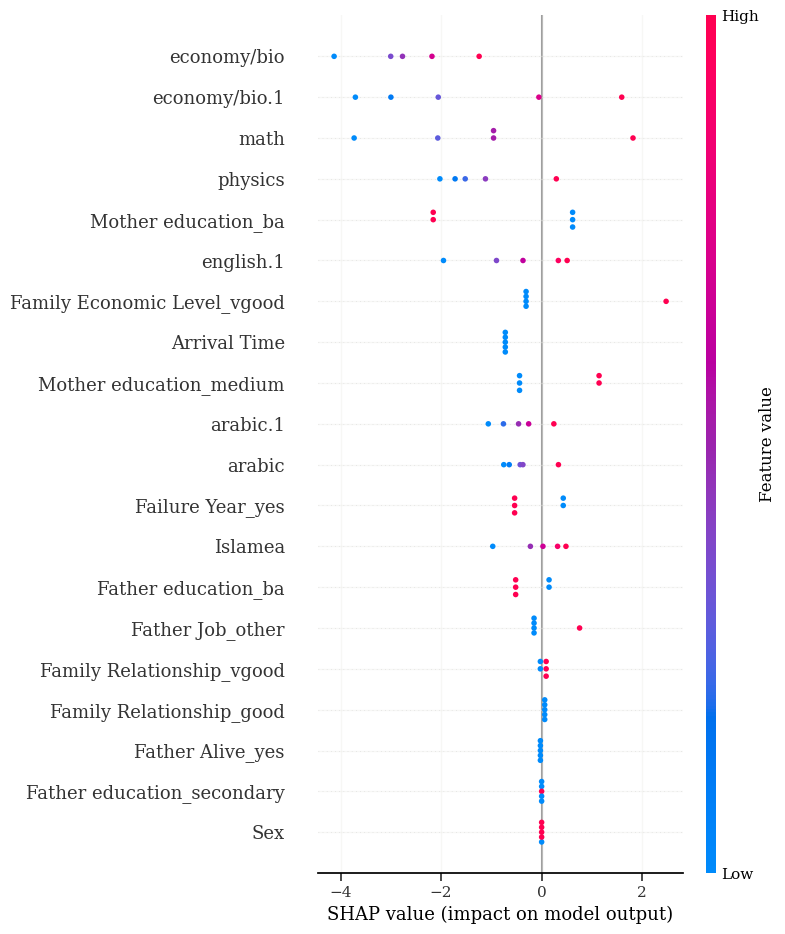

In [ ]:
import shap
import lime
import lime.lime_tabular
import numpy as np

# Step 1: Create a SHAP explainer object
explainer_shap_elastic_net = shap.Explainer(elastic_net_model, X_train)

# Step 2: Compute SHAP values
shap_values_elastic_net = explainer_shap_elastic_net.shap_values(X_test)

# Step 3: Visualize SHAP summary plot
shap.summary_plot(shap_values_elastic_net, X_test, feature_names=X_all.columns)

# Step 4: Create a LIME explainer object
explainer_lime_elastic_net = lime.lime_tabular.LimeTabularExplainer(X_train, mode="regression", feature_names=X_all.columns)

# Step 5: Explain an instance using LIME
exp_elastic_net = explainer_lime_elastic_net.explain_instance(X_test[1], elastic_net_model.predict, num_features=10)

# Step 6: Visualize the explanation
exp_elastic_net.show_in_notebook()


In [ ]:
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Instantiate the Ridge Regression model
ridge_model = Ridge()

# Fit the model to the training data
ridge_model.fit(X_train, y_train)

# Make predictions
predictions_ridge = ridge_model.predict(X_test)

# Calculate Mean Absolute Percentage Error (MAPE)
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape = mean_absolute_percentage_error(y_test, predictions_elastic_net)
print(f'MAPE: {mape:.2f}%')

# Evaluate the model
mae_ridge = mean_absolute_error(y_test, predictions_ridge)
mse_ridge = mean_squared_error(y_test, predictions_ridge)
r2_ridge = r2_score(y_test, predictions_ridge)

print(f'Ridge Regression Mean Absolute Error: {mae_ridge}')
print(f'Ridge Regression Mean Squared Error: {mse_ridge}')
print(f'Ridge Regression R^2 Score: {r2_ridge}')


MAPE: 8.73%
Ridge Regression Mean Absolute Error: 4.21220828356748
Ridge Regression Mean Squared Error: 29.446445560083134
Ridge Regression R^2 Score: 0.27543194980110397


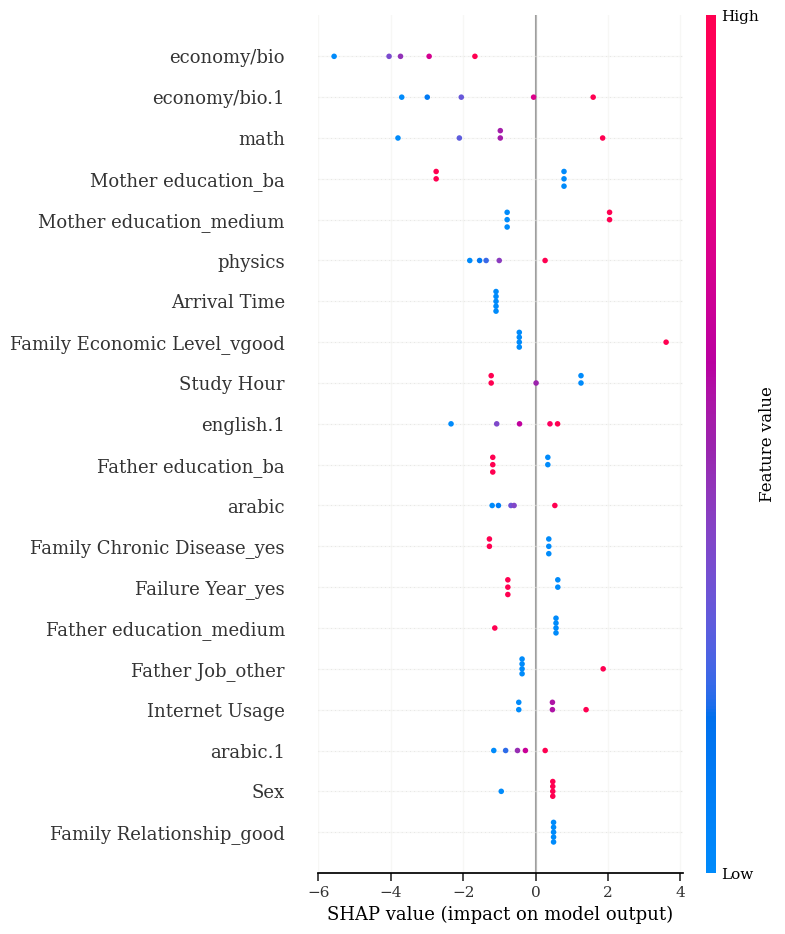

In [ ]:
import shap
import lime
import lime.lime_tabular
import numpy as np

# Step 1: Create a SHAP explainer object
explainer_shap_ridge = shap.Explainer(ridge_model, X_train)

# Step 2: Compute SHAP values
shap_values_ridge = explainer_shap_ridge.shap_values(X_test)

# Step 3: Visualize SHAP summary plot
shap.summary_plot(shap_values_ridge, X_test, feature_names=X_all.columns)

# Step 4: Create a LIME explainer object
explainer_lime_ridge = lime.lime_tabular.LimeTabularExplainer(X_train, mode="regression", feature_names=X_all.columns)

# Step 5: Explain an instance using LIME
exp_ridge = explainer_lime_ridge.explain_instance(X_test[1], ridge_model.predict, num_features=10)

# Step 6: Visualize the explanation
exp_ridge.show_in_notebook()


In [ ]:
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Instantiate the Lasso Regression model
lasso_model = Lasso()

# Fit the model to the training data
lasso_model.fit(X_train, y_train)

# Make predictions
predictions_lasso = lasso_model.predict(X_test)

# Calculate Mean Absolute Percentage Error (MAPE)
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape = mean_absolute_percentage_error(y_test, predictions_elastic_net)
print(f'MAPE: {mape:.2f}%')

# Evaluate the model
mae_lasso = mean_absolute_error(y_test, predictions_lasso)
mse_lasso = mean_squared_error(y_test, predictions_lasso)
r2_lasso = r2_score(y_test, predictions_lasso)

print(f'Lasso Regression Mean Absolute Error: {mae_lasso}')
print(f'Lasso Regression Mean Squared Error: {mse_lasso}')
print(f'Lasso Regression R^2 Score: {r2_lasso}')

MAPE: 8.73%
Lasso Regression Mean Absolute Error: 2.441020945485957
Lasso Regression Mean Squared Error: 18.927267551597765
Lasso Regression R^2 Score: 0.5342699913484801


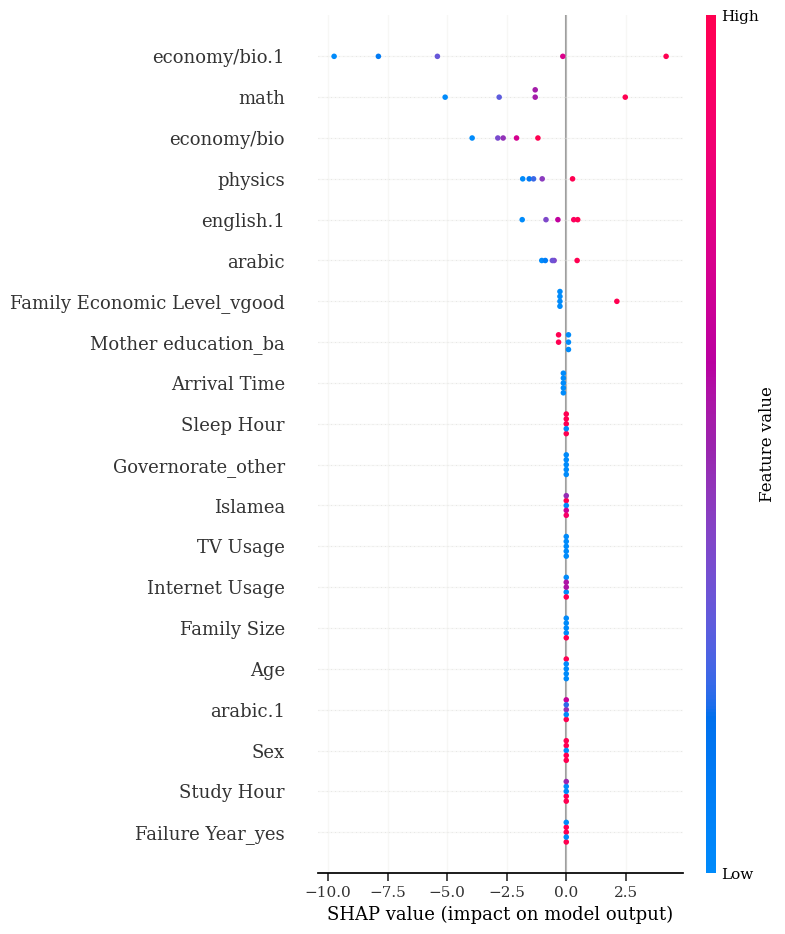

In [ ]:
import shap
import lime
import lime.lime_tabular
import numpy as np

# Step 1: Create a SHAP explainer object
explainer_shap = shap.Explainer(lasso_model, X_train)

# Step 2: Compute SHAP values
shap_values = explainer_shap.shap_values(X_test)

# Step 3: Visualize SHAP summary plot
shap.summary_plot(shap_values, X_test, feature_names=X_all.columns)

# Step 4: Create a LIME explainer object
explainer_lime = lime.lime_tabular.LimeTabularExplainer(X_train, mode="regression", feature_names=X_all.columns)

# Step 5: Explain an instance using LIME
exp = explainer_lime.explain_instance(X_test[1], lasso_model.predict, num_features=10)

# Step 6: Visualize the explanation
exp.show_in_notebook()
